In [1]:
!conda install -y tensorflow-gpu"=>2.1.0"

Solving environment: \ 
The environment is inconsistent, please check the package plan carefully
The following packages are causing the inconsistency:

  - defaults/linux-64::bkcharts==0.2=py36_0
  - defaults/noarch::dask==2.14.0=py_0
  - defaults/linux-64::pytest-arraydiff==0.3=py36h39e3cac_0
  - defaults/linux-64::bottleneck==1.3.2=py36heb32a55_0
  - defaults/linux-64::pywavelets==1.1.1=py36h7b6447c_0
  - defaults/noarch::keras-preprocessing==1.1.0=py_1
  - defaults/noarch::pytest-astropy==0.8.0=py_0
  - defaults/noarch::keras==2.4.3=0
  - defaults/linux-64::numexpr==2.7.1=py36h423224d_0
  - defaults/linux-64::h5py==2.10.0=py36h7918eee_0
  - defaults/linux-64::pandas==1.0.5=py36h0573a6f_0
  - defaults/linux-64::numpy-base==1.18.1=py36hde5b4d6_1
  - defaults/linux-64::tensorflow==2.2.0=gpu_py36hf933387_0
  - defaults/linux-64::tensorflow-gpu==2.2.0=h0d30ee6_0
  - defaults/linux-64::patsy==0.5.1=py36_0
  - defaults/linux-64::scikit-image==0.16.2=py36h0573a6f_0
  - defaults/linux-64::ma

In [2]:
import matplotlib.pyplot as plt
from tensorflow.python.client import device_lib
device_lib.list_local_devices()



[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 4393183534699037564,
 name: "/device:XLA_CPU:0"
 device_type: "XLA_CPU"
 memory_limit: 17179869184
 locality {
 }
 incarnation: 8658206919505605034
 physical_device_desc: "device: XLA_CPU device",
 name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 15625444416
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 6791138726791796916
 physical_device_desc: "device: 0, name: Tesla V100-SXM2-16GB, pci bus id: 0000:00:1e.0, compute capability: 7.0",
 name: "/device:XLA_GPU:0"
 device_type: "XLA_GPU"
 memory_limit: 17179869184
 locality {
 }
 incarnation: 1662429378349463841
 physical_device_desc: "device: XLA_GPU device"]

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
import matplotlib.animation as animation
import os
import cv2 as cv
from random import randint

def normalize(array):

    normalized = (array - np.amin(array)) / (np.amax(array) - np.amin(array))

    return normalized

class GANDatasetSingle:

    def __init__(self, in_path, out_path, filelimiter): #if filelimiter is -1 or > 943, unlimited.
        
        self.in_path = in_path
        self.out_path = out_path

        self.x_train = []
        self.y_train = []

        self.x_train_files = os.listdir(in_path)
        self.y_train_files = os.listdir(out_path)

        for i in range(0, len(self.x_train_files)):

            self.x_train_files[i] = self.x_train_files[i][0:4]

        for i in range(0, len(self.y_train_files)):

            self.y_train_files[i] = self.y_train_files[i][0:4]

        print("Length of x_train files: {}".format(len(self.x_train_files)))
        print("Length of y_train files: {}".format(len(self.y_train_files)))

        main_list = np.setdiff1d(self.x_train_files, self.y_train_files)

        print("LENGTH OF MAIN LIST: {}".format(len(main_list)))

        '''

        for item in main_list:

            if (item[0] != '.'):

                if item in x_train_files:

                    os.remove(os.path.join(in_path, item + ".png"))
                
                elif item in y_train_files:

                    os.remove(os.path.join(out_path, item + ".npy"))

        '''

        # ^^ removing files present in one (x, y) and not other (x, y) to prevent dataset misalignment

        self.x_train_paths = []
        self.y_train_paths = []

        for item in os.listdir(in_path):

            if (item[-3: ] == 'png'):

                self.x_train_paths.append(item)

        for item in os.listdir(out_path):

            if (item[-3: ] == 'npy'):

                self.y_train_paths.append(item)

        self.x_train_paths = sorted(self.x_train_paths)
        self.y_train_paths = sorted(self.y_train_paths)

        self.keys = []

        for file in self.y_train_paths:

            self.keys.append(file[0:4])

        print("Length of keys: {}".format(len(self.keys)))

        if (filelimiter < 1 or filelimiter> len(self.x_train_paths)):

            filelimiter = len(self.x_train_paths)

        for i in range(0, filelimiter):

            pt_in = os.path.join(in_path, self.x_train_paths[i])
            pt_out = os.path.join(out_path, self.y_train_paths[i])

            self.x_train.append(cv.imread(pt_in, cv.IMREAD_GRAYSCALE))
            self.y_train.append(np.load(pt_out))

        self.x_train = np.array(self.x_train).astype('float64')
        self.x_train /= np.amax(self.x_train)
        
        for i in range(0, len(self.y_train)):

            item = self.y_train[i]
            item = np.clip(item, -1000, 3000)
            print("Item {} with max: {} and min: {}".format(i, np.amax(self.y_train[i]), np.amin(self.y_train[i])))
            normalized = normalize(item)
            self.y_train[i] = normalized
            print("Normalized item {} with max: {} and min: {}".format(i, np.amax(self.y_train[i]), np.amin(self.y_train[i])))
        
        self.y_train = np.array(self.y_train).astype('float64')


    def view_pair(self, index):

        f = plt.figure()

        f.add_subplot(1, 2, 1)
        plt.imshow(self.x_train[index], cmap = 'gray')
        plt.title('Radiograph of {}'.format(index))
        f.add_subplot(1, 2, 2)
        plt.imshow(self.y_train[index][64], cmap = 'gray')
        plt.title("Tomography of {}".format(index))
        plt.show(block = True)

    def view_animation(self, index):

        if (self.y_train):

            array = self.y_train[index]

            ims = []

            for im in array:

                gg = plt.imshow(im, cmap = 'gray')
                ims.append([gg])

            fig = plt.figure()
            ani = animation.ArtistAnimation(fig, ims, interval = 50, blit = True)
            plt.title(index)
            plt.show()

        else:

            print("Error: dataset has not been initialized yet")

    def prepare(self, num_train):

        self.x_val = self.x_train[num_train: len(self.x_train)]
        self.x_train = self.x_train[0:num_train]


        self.y_val = self.y_train[num_train : len(self.y_train)]
        self.y_train = self.y_train[0: num_train]


        self.x_train = np.reshape(self.x_train, (len(self.x_train), 1024, 1024, 1))
        self.y_train = np.reshape(self.y_train, (len(self.y_train), 128, 128, 128, 1))

        self.x_val = np.reshape(self.x_val, (len(self.x_val), 1024, 1024, 1))
        self.y_val = np.reshape(self.y_val, (len(self.y_val), 128, 128, 128, 1))

        print("Shape of X Train: {}".format(self.x_train.shape))
        print("Shape of Y Train: {}".format(self.y_train.shape))
        print("Shape of X Validation: {}".format(self.x_val.shape))
        print("Shape of Y Validation: {}".format(self.y_val.shape))

    def save_data(self, model, truth_out_dir, pred_out_dir, save_truths = False):

        self.model = model #tensorflow.keras model

        for i in range(0, len(self.keys)):

            input = np.reshape(self.x_train[i], (1, 1024, 1024, 1))
            output = model.predict(input)
            output = np.reshape(output, (128, 128, 128))

            if (save_truths):

                truth = np.reshape(self.y_train[i], (128, 128, 128))
                np.save(os.path.join(truth_out_dir, self.keys[i]), truth)

            np.save(os.path.join(pred_out_dir, self.keys[i]), output)
            print(self.keys[i])

    def generate_real_samples(self, n_samples, patch_shape):

        ix = np.random.randint(0, self.x_train.shape[0], n_samples)

        X1, X2 = self.x_train[ix], self.y_train[ix]
        
        y = np.ones((n_samples, patch_shape, patch_shape, 1))
        return [X1, X2], y

    def generate_fake_samples(self, g_model, samples, patch_shape):

        X = g_model.predict(samples)
        y = np.zeros((len(X), patch_shape, patch_shape, 1))
        return X, y

    def train(self, d_model, g_model, gan_model, n_epochs = 100, n_batch = 1, n_patch = 16):

        self.d1_losses = []
        self.d2_losses = []
        self.g_losses = []

        self.d1_epoch_losses = []
        self.d2_epoch_losses = []
        self.g_epoch_losses = []

        bat_per_epo = int(len(self.x_train) / n_batch)

        n_steps = bat_per_epo * n_epochs

        for i in range(n_steps):

            [X_realA, X_realB], y_real = self.generate_real_samples(n_batch, n_patch)
            X_fakeB, y_fake = self.generate_fake_samples(g_model, X_realA, n_patch)
            d_loss1 = d_model.train_on_batch([X_realA, X_realB], y_real)
            d_loss2 = d_model.train_on_batch([X_realA, X_fakeB], y_fake)

            g_loss, _, _ = gan_model.train_on_batch(X_realA, [y_real, X_realB])

            self.d1_losses.append(d_loss1)
            self.d2_losses.append(d_loss2)
            self.g_losses.append(g_loss)
            
            print('>%d, d1[%.3f] d2[%.3f] g[%.3f]' % (i+1, d_loss1, d_loss2, g_loss))

            if (i % len(self.x_train) == 0):

                self.d1_epoch_losses.append(d_loss1)
                self.d2_epoch_losses.append(d_loss2)
                self.g_epoch_losses.append(g_loss)

                temp_in = np.reshape(self.x_train[555], (1, 1024, 1024, 1))
                temp_out = g_model.predict(temp_in)
                temp_out = np.reshape(temp_out, (128, 128, 128))
                real_out = np.reshape(self.y_train[555], (128, 128, 128))

                f = plt.figure()
                f.add_subplot(1, 2, 1)
                plt.imshow(real_out[64], cmap = 'gray')

                f.add_subplot(1, 2, 2)
                plt.imshow(temp_out[64], cmap = 'gray')

                plt.suptitle("Epoch: {}".format(int(i / len(self.x_train))))

                plt.show(block = True)


In [4]:
gd = GANDatasetSingle('In/0', 'Out_New', 0)

Length of x_train files: 943
Length of y_train files: 943
LENGTH OF MAIN LIST: 0
Length of keys: 943
Item 0 with max: 3482 and min: -2180
Normalized item 0 with max: 1.0 and min: 0.0
Item 1 with max: 1681 and min: -1108
Normalized item 1 with max: 1.0 and min: 0.0
Item 2 with max: 5660 and min: -2212
Normalized item 2 with max: 1.0 and min: 0.0
Item 3 with max: 3564 and min: -1221
Normalized item 3 with max: 1.0 and min: 0.0
Item 4 with max: 3452 and min: -2218
Normalized item 4 with max: 1.0 and min: 0.0
Item 5 with max: 3378 and min: -2213
Normalized item 5 with max: 1.0 and min: 0.0
Item 6 with max: 3744 and min: -2186
Normalized item 6 with max: 1.0 and min: 0.0
Item 7 with max: 3495 and min: -2201
Normalized item 7 with max: 1.0 and min: 0.0
Item 8 with max: 1730 and min: -1078
Normalized item 8 with max: 1.0 and min: 0.0
Item 9 with max: 3420 and min: -1118
Normalized item 9 with max: 1.0 and min: 0.0
Item 10 with max: 3547 and min: -2167
Normalized item 10 with max: 1.0 and min:

In [5]:
gd.prepare(943)

Shape of X Train: (943, 1024, 1024, 1)
Shape of Y Train: (943, 128, 128, 128, 1)
Shape of X Validation: (0, 1024, 1024, 1)
Shape of Y Validation: (0, 128, 128, 128, 1)


In [6]:
!conda install keras --yes

Solving environment: | 
The environment is inconsistent, please check the package plan carefully
The following packages are causing the inconsistency:

  - defaults/linux-64::bkcharts==0.2=py36_0
  - defaults/noarch::dask==2.14.0=py_0
  - defaults/linux-64::pytest-arraydiff==0.3=py36h39e3cac_0
  - defaults/linux-64::bottleneck==1.3.2=py36heb32a55_0
  - defaults/linux-64::pywavelets==1.1.1=py36h7b6447c_0
  - defaults/noarch::keras-preprocessing==1.1.0=py_1
  - defaults/noarch::pytest-astropy==0.8.0=py_0
  - defaults/noarch::keras==2.4.3=0
  - defaults/linux-64::numexpr==2.7.1=py36h423224d_0
  - defaults/linux-64::h5py==2.10.0=py36h7918eee_0
  - defaults/linux-64::pandas==1.0.5=py36h0573a6f_0
  - defaults/linux-64::numpy-base==1.18.1=py36hde5b4d6_1
  - defaults/linux-64::tensorflow==2.2.0=gpu_py36hf933387_0
  - defaults/linux-64::tensorflow-gpu==2.2.0=h0d30ee6_0
  - defaults/linux-64::patsy==0.5.1=py36_0
  - defaults/linux-64::scikit-image==0.16.2=py36h0573a6f_0
  - defaults/linux-64::ma

In [7]:
from keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, Conv3D, MaxPooling3D, UpSampling3D, Reshape, Flatten, Dense
from keras.layers.merge import concatenate
from keras.models import Model
from keras.datasets import mnist
from keras.callbacks import TensorBoard
from keras import backend as K
from keras.optimizers import Adam
from tensorflow.keras.utils import plot_model
import numpy as np
import matplotlib.pyplot as plt
import pickle

def define_discriminator():

  input_img_1 = Input(shape=(128, 128, 128, 1))    # adapt this if using 'channels_first' image data format
  input_img_2 = Input(shape = (1024, 1024, 1))

  x = Conv3D(64, (3, 3, 3), activation='relu', padding='same')(input_img_1)
  x = MaxPooling3D((2, 2, 2), padding='same')(x)
  x = Conv3D(128, (3, 3, 3), activation='relu', padding='same')(x)
  x = MaxPooling3D((2, 2, 2), padding='same')(x)
  x = Conv3D(256, (3, 3, 3), activation='relu', padding='same')(x)
  x = MaxPooling3D((2, 2, 2), padding='same')(x)
  x = Conv3D(512, (3, 3, 3), activation='relu', padding='same')(x)
  x = MaxPooling3D((2, 2, 2), padding='same')(x)
  x = Conv3D(1024, (3, 3, 3), activation='relu', padding='same')(x)
  x = MaxPooling3D((2, 2, 2), padding='same')(x)
  x = Conv3D(2048, (3, 3, 3), activation='relu', padding='same')(x)
  x = MaxPooling3D((2, 2, 2), padding='same')(x)
  x = Reshape((2, 2, 4096))(x)

  y = Conv2D(32, (3, 3), activation = "relu", padding = 'same')(input_img_2)
  y = MaxPooling2D((2, 2), padding = 'same')(y)
  y = Conv2D(64, (3, 3), activation = "relu", padding = 'same')(y)
  y = MaxPooling2D((2, 2), padding = 'same')(y)
  y = Conv2D(128, (3, 3), activation = "relu", padding = 'same')(y)
  y = MaxPooling2D((2, 2), padding = 'same')(y)
  y = Conv2D(256, (3, 3), activation = "relu", padding = 'same')(y)
  y = MaxPooling2D((2, 2), padding = 'same')(y)
  y = Conv2D(512, (3, 3), activation = "relu", padding = 'same')(y)
  y = MaxPooling2D((2, 2), padding = 'same')(y)
  y = Conv2D(512, (3, 3), activation = "relu", padding = 'same')(y)
  y = MaxPooling2D((2, 2), padding = 'same')(y)
  y = Conv2D(1024, (3, 3), activation = "relu", padding = 'same')(y)
  y = MaxPooling2D((2, 2), padding = 'same')(y)
  y = Conv2D(2048, (3, 3), activation = "relu", padding = 'same')(y)
  y = MaxPooling2D((2, 2), padding = 'same')(y)
  y = Conv2D(4096, (3, 3), activation = "relu", padding = 'same')(y)
  y = MaxPooling2D((2, 2), padding = 'same')(y)

  encoded = concatenate([x, y])
  encoded = Reshape(target_shape=(32, 32, 32))(encoded)
  encoded = Conv2D(16, (3, 3), activation = 'relu', padding = 'same')(encoded)
  encoded = MaxPooling2D((2, 2), padding = 'same')(encoded)
  encoded = Conv2D(1, (1, 1), activation = 'relu', padding = 'same')(encoded)
  
  discriminator = Model([input_img_2, input_img_1], encoded)
  discriminator.summary()

  opt = Adam(learning_rate=0.0002, beta_1 = 0.5)
  discriminator.compile(loss = 'binary_crossentropy', optimizer = opt, loss_weights = [0.5])
  return discriminator

d_model = define_discriminator()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 1024, 1024,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 1024, 1024, 3 320         input_2[0][0]                    
__________________________________________________________________________________________________
max_pooling2d (MaxPooling2D)    (None, 512, 512, 32) 0           conv2d[0][0]                     
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 512, 512, 64) 18496       max_pooling2d[0][0]              
______________________________________________________________________________________________

In [8]:
from keras.initializers import RandomNormal

def define_generator():

  input_img = Input((1024, 1024, 1))

  init = RandomNormal(stddev = 0.02)

  x = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img)
  x = MaxPooling2D((2, 2), padding='same')(x)
  x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
  x = MaxPooling2D((2, 2), padding='same')(x)
  x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
  x = MaxPooling2D((2, 2), padding='same')(x)
  x = Conv2D(256, (3, 3), activation='relu', padding='same')(x)
  x = MaxPooling2D((2, 2), padding='same')(x)
  x = Conv2D(512, (3, 3), activation='relu', padding='same')(x)
  x = MaxPooling2D((2, 2), padding='same')(x)
  x = Conv2D(1024, (3, 3), activation='relu', padding='same')(x)
  x = MaxPooling2D((2, 2), padding='same')(x)
  x = Conv2D(2048, (3, 3), activation='relu', padding='same')(x)
  x = MaxPooling2D((2, 2), padding='same')(x)
  x = Conv2D(4096, (3, 3), activation='relu', padding='same', kernel_initializer=init)(x)
  encoded = MaxPooling2D((2, 2), padding='same')(x)

  encoded = Reshape((4, 4, 4, 1024))(encoded)

  x = Conv3D(512, (3, 3, 3), activation = 'relu', padding = 'same')(encoded)
  x = UpSampling3D((2, 2, 2))(x)

  x = Conv3D(256, (3, 3, 3), activation = 'relu', padding = 'same')(x)
  x = UpSampling3D((2, 2, 2))(x)

  x = Conv3D(128, (3, 3, 3), activation = 'relu', padding = 'same')(x)
  x = UpSampling3D((2, 2, 2))(x)

  x = Conv3D(64, (3, 3, 3), activation = 'relu', padding = 'same')(x)
  x = UpSampling3D((2, 2, 2))(x)

  x = Conv3D(32, (3, 3, 3), activation = 'relu', padding = 'same')(x)
  x = UpSampling3D((2, 2, 2))(x)

  decoded = Conv3D(1, (1, 1, 1), activation = 'relu', padding = 'same')(x)

  generator = Model(input_img, decoded)
  return generator

g_model = define_generator()

In [9]:
def make_gan(g_model, d_model):

  d_model.trainable = False
   
  in_src = Input((1024, 1024, 1))

  gen_out = g_model(in_src)

  dis_out = d_model([in_src, gen_out])

  model = Model(in_src, [dis_out, gen_out])

  opt = Adam(lr = 0.0002, beta_1 = 0.5)
  model.compile(loss = ['binary_crossentropy', 'mse'], optimizer = opt, loss_weights = [1, 1])
  return model

In [10]:
gan = make_gan(g_model, d_model)

In [11]:
gan.summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 1024, 1024,  0                                            
__________________________________________________________________________________________________
model_1 (Model)                 (None, 128, 128, 128 119522561   input_4[0][0]                    
__________________________________________________________________________________________________
model (Model)                   (None, 16, 16, 1)    178459553   input_4[0][0]                    
                                                                 model_1[1][0]                    
Total params: 297,982,114
Trainable params: 119,522,561
Non-trainable params: 178,459,553
__________________________________________________________________________________________________


>1, d1[7.649] d2[0.003] g[17.550]


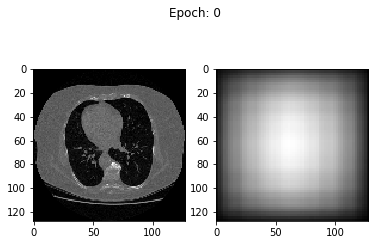

>2, d1[7.537] d2[0.013] g[73.567]
>3, d1[7.483] d2[0.021] g[19.841]
>4, d1[7.484] d2[0.009] g[22.608]
>5, d1[7.486] d2[0.009] g[17.733]
>6, d1[7.485] d2[0.010] g[17.176]
>7, d1[7.483] d2[0.013] g[16.395]
>8, d1[7.483] d2[0.010] g[17.281]
>9, d1[7.484] d2[0.013] g[17.586]
>10, d1[7.485] d2[0.009] g[17.667]
>11, d1[7.484] d2[0.009] g[19.466]
>12, d1[7.483] d2[0.010] g[18.355]
>13, d1[7.481] d2[0.010] g[20.920]
>14, d1[7.460] d2[0.011] g[18.218]
>15, d1[7.200] d2[0.170] g[19.736]
>16, d1[6.652] d2[1.395] g[14.430]
>17, d1[6.398] d2[0.055] g[14.049]
>18, d1[6.011] d2[0.018] g[16.620]
>19, d1[5.764] d2[0.217] g[14.155]
>20, d1[5.488] d2[0.006] g[15.483]
>21, d1[5.310] d2[0.033] g[16.309]
>22, d1[5.234] d2[0.011] g[15.450]
>23, d1[5.115] d2[0.007] g[17.417]
>24, d1[4.932] d2[0.009] g[15.070]
>25, d1[4.865] d2[0.007] g[17.002]
>26, d1[4.864] d2[0.006] g[16.793]
>27, d1[4.864] d2[0.007] g[15.753]
>28, d1[4.863] d2[0.007] g[19.825]
>29, d1[4.865] d2[0.006] g[16.185]
>30, d1[4.863] d2[0.007] g[1

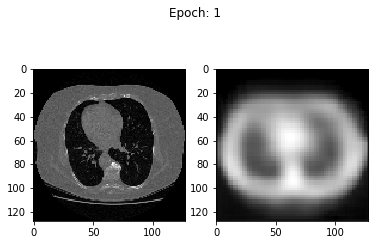

>945, d1[1.288] d2[5.919] g[3.340]
>946, d1[1.288] d2[5.919] g[3.708]
>947, d1[1.288] d2[5.919] g[3.265]
>948, d1[1.288] d2[5.919] g[3.579]
>949, d1[1.288] d2[5.919] g[4.642]
>950, d1[1.288] d2[5.919] g[4.321]
>951, d1[1.288] d2[5.919] g[3.751]
>952, d1[1.288] d2[5.919] g[4.411]
>953, d1[1.288] d2[5.919] g[3.890]
>954, d1[1.288] d2[5.919] g[4.366]
>955, d1[1.288] d2[5.919] g[3.511]
>956, d1[1.318] d2[5.919] g[4.403]
>957, d1[1.288] d2[5.919] g[3.617]
>958, d1[1.288] d2[5.919] g[4.145]
>959, d1[1.378] d2[5.919] g[3.596]
>960, d1[1.288] d2[5.919] g[5.285]
>961, d1[1.288] d2[5.919] g[3.458]
>962, d1[1.288] d2[5.919] g[3.945]
>963, d1[1.288] d2[5.919] g[4.340]
>964, d1[1.288] d2[5.919] g[4.098]
>965, d1[1.288] d2[5.919] g[3.250]
>966, d1[1.288] d2[5.919] g[3.875]
>967, d1[1.288] d2[5.919] g[5.063]
>968, d1[1.288] d2[5.919] g[3.228]
>969, d1[1.288] d2[5.919] g[4.335]
>970, d1[1.288] d2[5.919] g[3.221]
>971, d1[1.288] d2[5.919] g[3.178]
>972, d1[1.318] d2[5.919] g[4.085]
>973, d1[1.288] d2[5

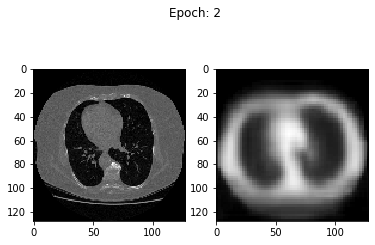

>1888, d1[0.836] d2[6.366] g[3.018]
>1889, d1[0.836] d2[6.366] g[3.868]
>1890, d1[0.836] d2[6.366] g[2.314]
>1891, d1[0.836] d2[6.366] g[2.391]
>1892, d1[0.836] d2[6.366] g[3.617]
>1893, d1[0.836] d2[6.366] g[3.044]
>1894, d1[0.836] d2[6.366] g[2.730]
>1895, d1[0.896] d2[6.366] g[2.630]
>1896, d1[0.836] d2[6.366] g[2.185]
>1897, d1[0.836] d2[6.366] g[2.223]
>1898, d1[0.836] d2[6.366] g[2.372]
>1899, d1[0.836] d2[6.366] g[2.900]
>1900, d1[0.836] d2[6.366] g[2.186]
>1901, d1[0.836] d2[6.366] g[2.279]
>1902, d1[0.836] d2[6.366] g[2.122]
>1903, d1[0.836] d2[6.366] g[2.841]
>1904, d1[0.836] d2[6.366] g[2.657]
>1905, d1[0.836] d2[6.366] g[3.036]
>1906, d1[0.836] d2[6.366] g[2.615]
>1907, d1[0.836] d2[6.366] g[2.944]
>1908, d1[0.836] d2[6.366] g[2.200]
>1909, d1[0.836] d2[6.366] g[2.829]
>1910, d1[0.836] d2[6.366] g[4.388]
>1911, d1[0.836] d2[6.366] g[3.602]
>1912, d1[0.836] d2[6.366] g[3.932]
>1913, d1[0.836] d2[6.366] g[4.186]
>1914, d1[0.836] d2[6.366] g[3.153]
>1915, d1[0.836] d2[6.366] g

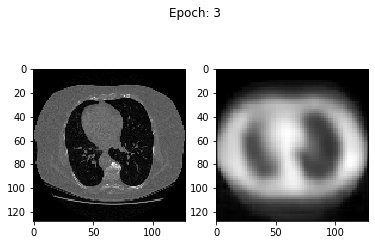

>2831, d1[0.836] d2[6.366] g[2.251]
>2832, d1[0.836] d2[6.366] g[2.156]
>2833, d1[0.836] d2[6.366] g[2.308]
>2834, d1[0.836] d2[6.366] g[2.130]
>2835, d1[0.836] d2[6.366] g[3.118]
>2836, d1[0.836] d2[6.366] g[2.870]
>2837, d1[0.836] d2[6.366] g[2.501]
>2838, d1[0.836] d2[6.366] g[2.121]
>2839, d1[0.836] d2[6.366] g[2.437]
>2840, d1[0.836] d2[6.366] g[2.225]
>2841, d1[0.836] d2[6.366] g[2.561]
>2842, d1[0.836] d2[6.366] g[2.492]
>2843, d1[0.836] d2[6.366] g[2.189]
>2844, d1[0.836] d2[6.366] g[3.449]
>2845, d1[0.836] d2[6.366] g[2.196]
>2846, d1[0.836] d2[6.366] g[2.069]
>2847, d1[0.836] d2[6.366] g[2.734]
>2848, d1[0.836] d2[6.366] g[2.749]
>2849, d1[0.836] d2[6.366] g[2.932]
>2850, d1[0.836] d2[6.366] g[2.705]
>2851, d1[0.836] d2[6.366] g[2.404]
>2852, d1[0.836] d2[6.366] g[3.208]
>2853, d1[0.836] d2[6.366] g[2.628]
>2854, d1[0.836] d2[6.366] g[2.871]
>2855, d1[0.836] d2[6.366] g[2.363]
>2856, d1[0.836] d2[6.366] g[2.628]
>2857, d1[0.836] d2[6.366] g[3.561]
>2858, d1[0.836] d2[6.366] g

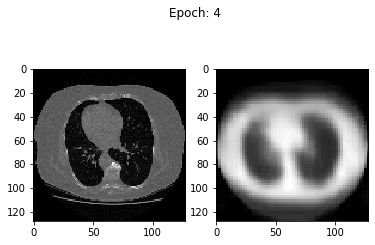

>3774, d1[0.836] d2[6.366] g[2.745]
>3775, d1[0.836] d2[6.366] g[2.719]
>3776, d1[0.836] d2[6.366] g[2.587]
>3777, d1[0.836] d2[6.366] g[2.822]
>3778, d1[0.836] d2[6.366] g[2.178]
>3779, d1[0.836] d2[6.366] g[2.278]
>3780, d1[0.836] d2[6.366] g[3.940]
>3781, d1[0.836] d2[6.366] g[2.212]
>3782, d1[0.836] d2[6.366] g[2.247]
>3783, d1[0.836] d2[6.366] g[2.318]
>3784, d1[0.836] d2[6.366] g[2.348]
>3785, d1[0.836] d2[6.366] g[2.244]
>3786, d1[0.836] d2[6.366] g[2.063]
>3787, d1[0.836] d2[6.366] g[2.674]
>3788, d1[0.836] d2[6.366] g[2.226]
>3789, d1[0.836] d2[6.366] g[3.429]
>3790, d1[0.836] d2[6.366] g[3.277]
>3791, d1[0.836] d2[6.366] g[2.467]
>3792, d1[0.836] d2[6.366] g[2.931]
>3793, d1[0.836] d2[6.366] g[2.035]
>3794, d1[0.836] d2[6.366] g[2.193]
>3795, d1[0.836] d2[6.366] g[2.231]
>3796, d1[0.836] d2[6.366] g[3.301]
>3797, d1[0.836] d2[6.366] g[2.792]
>3798, d1[0.836] d2[6.366] g[2.206]
>3799, d1[0.836] d2[6.366] g[2.351]
>3800, d1[0.836] d2[6.366] g[3.413]
>3801, d1[0.836] d2[6.366] g

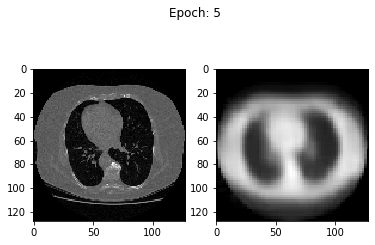

>4717, d1[0.836] d2[6.366] g[2.696]
>4718, d1[0.836] d2[6.366] g[2.505]
>4719, d1[0.836] d2[6.366] g[2.766]
>4720, d1[0.836] d2[6.366] g[3.411]
>4721, d1[0.836] d2[6.366] g[2.420]
>4722, d1[0.836] d2[6.366] g[2.082]
>4723, d1[0.836] d2[6.366] g[2.578]
>4724, d1[0.836] d2[6.366] g[2.594]
>4725, d1[0.836] d2[6.366] g[2.542]
>4726, d1[0.836] d2[6.366] g[2.973]
>4727, d1[0.836] d2[6.366] g[3.436]
>4728, d1[0.836] d2[6.366] g[3.221]
>4729, d1[0.836] d2[6.366] g[2.492]
>4730, d1[0.836] d2[6.366] g[2.669]
>4731, d1[0.836] d2[6.366] g[2.596]
>4732, d1[0.836] d2[6.366] g[2.680]
>4733, d1[0.836] d2[6.366] g[2.271]
>4734, d1[0.836] d2[6.366] g[2.095]
>4735, d1[0.836] d2[6.366] g[2.497]
>4736, d1[0.836] d2[6.366] g[2.549]
>4737, d1[0.836] d2[6.366] g[3.179]
>4738, d1[0.836] d2[6.366] g[2.339]
>4739, d1[0.836] d2[6.366] g[2.342]
>4740, d1[0.836] d2[6.366] g[2.662]
>4741, d1[0.836] d2[6.366] g[2.480]
>4742, d1[0.836] d2[6.366] g[3.000]
>4743, d1[0.836] d2[6.366] g[2.583]
>4744, d1[0.836] d2[6.366] g

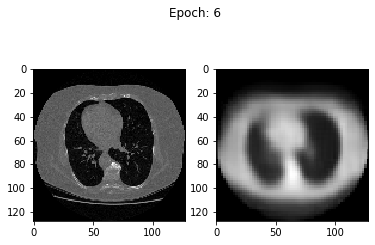

>5660, d1[0.844] d2[6.791] g[2.202]
>5661, d1[0.844] d2[6.791] g[2.936]
>5662, d1[0.844] d2[6.791] g[2.362]
>5663, d1[0.844] d2[6.791] g[2.093]
>5664, d1[0.844] d2[6.791] g[2.293]
>5665, d1[0.844] d2[6.791] g[2.706]
>5666, d1[0.844] d2[6.791] g[2.262]
>5667, d1[0.844] d2[6.791] g[2.222]
>5668, d1[0.844] d2[6.791] g[2.283]
>5669, d1[0.844] d2[6.791] g[2.216]
>5670, d1[0.844] d2[6.791] g[2.242]
>5671, d1[0.844] d2[6.791] g[2.157]
>5672, d1[0.844] d2[6.791] g[3.701]
>5673, d1[0.844] d2[6.791] g[2.259]
>5674, d1[0.844] d2[6.791] g[2.423]
>5675, d1[0.844] d2[6.791] g[2.021]
>5676, d1[0.844] d2[6.791] g[2.207]
>5677, d1[0.844] d2[6.791] g[2.823]
>5678, d1[0.844] d2[6.791] g[2.543]
>5679, d1[0.844] d2[6.791] g[3.015]
>5680, d1[0.844] d2[6.791] g[2.292]
>5681, d1[0.844] d2[6.791] g[2.435]
>5682, d1[0.844] d2[6.791] g[3.927]
>5683, d1[0.844] d2[6.791] g[2.408]
>5684, d1[0.844] d2[6.791] g[2.331]
>5685, d1[0.844] d2[6.791] g[2.149]
>5686, d1[0.844] d2[6.791] g[2.241]
>5687, d1[0.844] d2[6.791] g

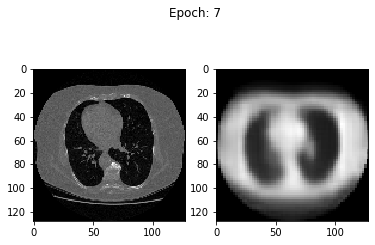

>6603, d1[0.844] d2[6.791] g[2.101]
>6604, d1[0.844] d2[6.791] g[3.707]
>6605, d1[0.844] d2[6.791] g[3.170]
>6606, d1[0.844] d2[6.791] g[2.276]
>6607, d1[0.844] d2[6.791] g[3.188]
>6608, d1[0.844] d2[6.791] g[2.845]
>6609, d1[0.844] d2[6.791] g[2.178]
>6610, d1[0.844] d2[6.791] g[2.554]
>6611, d1[0.844] d2[6.791] g[2.901]
>6612, d1[0.844] d2[6.791] g[2.591]
>6613, d1[0.844] d2[6.791] g[2.289]
>6614, d1[0.844] d2[6.791] g[2.448]
>6615, d1[0.844] d2[6.791] g[2.961]
>6616, d1[0.844] d2[6.791] g[2.727]
>6617, d1[0.844] d2[6.791] g[2.962]
>6618, d1[0.844] d2[6.791] g[2.367]
>6619, d1[0.844] d2[6.791] g[2.046]
>6620, d1[0.844] d2[6.791] g[2.172]
>6621, d1[0.844] d2[6.791] g[2.195]
>6622, d1[0.844] d2[6.791] g[2.253]
>6623, d1[0.844] d2[6.791] g[2.150]
>6624, d1[0.844] d2[6.791] g[3.940]
>6625, d1[0.844] d2[6.791] g[2.360]
>6626, d1[0.844] d2[6.791] g[2.709]
>6627, d1[0.844] d2[6.791] g[2.210]
>6628, d1[0.844] d2[6.791] g[2.739]
>6629, d1[0.844] d2[6.791] g[2.258]
>6630, d1[0.844] d2[6.791] g

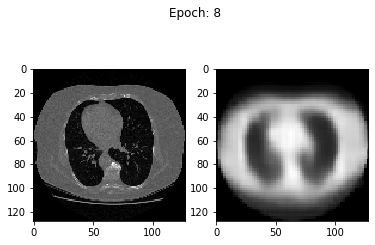

>7546, d1[0.844] d2[6.791] g[2.492]
>7547, d1[0.844] d2[6.791] g[2.073]
>7548, d1[0.844] d2[6.791] g[2.228]
>7549, d1[0.844] d2[6.791] g[3.475]
>7550, d1[0.844] d2[6.791] g[2.216]
>7551, d1[0.844] d2[6.791] g[2.116]
>7552, d1[0.844] d2[6.791] g[3.012]
>7553, d1[0.844] d2[6.791] g[2.335]
>7554, d1[0.844] d2[6.791] g[2.727]
>7555, d1[0.844] d2[6.791] g[2.751]
>7556, d1[0.844] d2[6.791] g[2.944]
>7557, d1[0.844] d2[6.791] g[2.682]
>7558, d1[0.844] d2[6.791] g[2.444]
>7559, d1[0.844] d2[6.791] g[2.303]
>7560, d1[0.844] d2[6.791] g[2.416]
>7561, d1[0.844] d2[6.791] g[2.538]
>7562, d1[0.844] d2[6.791] g[2.268]
>7563, d1[0.844] d2[6.791] g[2.749]
>7564, d1[0.844] d2[6.791] g[1.932]
>7565, d1[0.844] d2[6.791] g[2.257]
>7566, d1[0.844] d2[6.791] g[2.020]
>7567, d1[0.844] d2[6.791] g[2.135]
>7568, d1[0.844] d2[6.791] g[2.262]
>7569, d1[0.844] d2[6.791] g[2.028]
>7570, d1[0.844] d2[6.791] g[2.558]
>7571, d1[0.844] d2[6.791] g[2.333]
>7572, d1[0.844] d2[6.791] g[3.187]
>7573, d1[0.844] d2[6.791] g

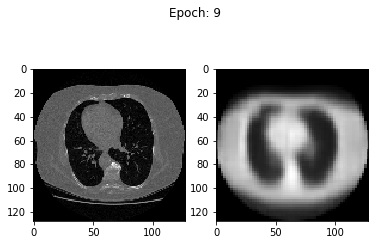

>8489, d1[0.844] d2[6.791] g[2.327]
>8490, d1[0.844] d2[6.791] g[2.379]
>8491, d1[0.844] d2[6.791] g[3.325]
>8492, d1[0.844] d2[6.791] g[2.450]
>8493, d1[0.844] d2[6.791] g[2.409]
>8494, d1[0.844] d2[6.791] g[3.033]
>8495, d1[0.844] d2[6.791] g[2.257]
>8496, d1[0.844] d2[6.791] g[2.115]
>8497, d1[0.844] d2[6.791] g[2.114]
>8498, d1[0.844] d2[6.791] g[2.100]
>8499, d1[0.844] d2[6.791] g[2.649]
>8500, d1[0.844] d2[6.791] g[2.261]
>8501, d1[0.844] d2[6.791] g[2.067]
>8502, d1[0.844] d2[6.791] g[2.641]
>8503, d1[0.844] d2[6.791] g[2.174]
>8504, d1[0.844] d2[6.791] g[2.261]
>8505, d1[0.844] d2[6.791] g[2.203]
>8506, d1[0.844] d2[6.791] g[2.235]
>8507, d1[0.844] d2[6.791] g[2.465]
>8508, d1[0.844] d2[6.791] g[2.035]
>8509, d1[0.844] d2[6.791] g[3.273]
>8510, d1[0.844] d2[6.791] g[2.205]
>8511, d1[0.844] d2[6.791] g[2.759]
>8512, d1[0.844] d2[6.791] g[2.012]
>8513, d1[0.844] d2[6.791] g[2.587]
>8514, d1[0.844] d2[6.791] g[2.369]
>8515, d1[0.844] d2[6.791] g[2.093]
>8516, d1[0.844] d2[6.791] g

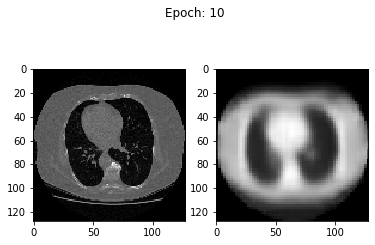

>9432, d1[0.844] d2[6.791] g[2.706]
>9433, d1[0.844] d2[6.791] g[2.664]
>9434, d1[0.844] d2[6.791] g[4.062]
>9435, d1[0.844] d2[6.791] g[2.311]
>9436, d1[0.844] d2[6.791] g[2.368]
>9437, d1[0.844] d2[6.791] g[2.596]
>9438, d1[0.844] d2[6.791] g[3.134]
>9439, d1[0.844] d2[6.791] g[2.589]
>9440, d1[0.844] d2[6.791] g[2.927]
>9441, d1[0.844] d2[6.791] g[2.351]
>9442, d1[0.844] d2[6.791] g[2.024]
>9443, d1[0.844] d2[6.791] g[2.457]
>9444, d1[0.844] d2[6.791] g[2.397]
>9445, d1[0.844] d2[6.791] g[2.684]
>9446, d1[0.844] d2[6.791] g[2.180]
>9447, d1[0.844] d2[6.791] g[2.124]
>9448, d1[0.844] d2[6.791] g[2.482]
>9449, d1[0.844] d2[6.791] g[2.068]
>9450, d1[0.844] d2[6.791] g[2.055]
>9451, d1[0.844] d2[6.791] g[2.595]
>9452, d1[0.844] d2[6.791] g[2.162]
>9453, d1[0.844] d2[6.791] g[3.062]
>9454, d1[0.844] d2[6.791] g[2.508]
>9455, d1[0.844] d2[6.791] g[2.378]
>9456, d1[0.844] d2[6.791] g[2.078]
>9457, d1[0.844] d2[6.791] g[2.774]
>9458, d1[0.844] d2[6.791] g[2.181]
>9459, d1[0.844] d2[6.791] g

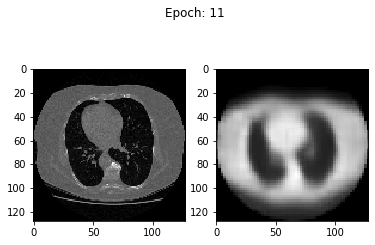

>10375, d1[0.844] d2[6.791] g[2.559]
>10376, d1[0.844] d2[6.791] g[2.662]
>10377, d1[0.844] d2[6.791] g[2.199]
>10378, d1[0.844] d2[6.791] g[2.406]
>10379, d1[0.844] d2[6.791] g[2.144]
>10380, d1[0.844] d2[6.791] g[2.865]
>10381, d1[0.844] d2[6.791] g[2.511]
>10382, d1[0.844] d2[6.791] g[2.280]
>10383, d1[0.844] d2[6.791] g[2.346]
>10384, d1[0.844] d2[6.791] g[2.737]
>10385, d1[0.844] d2[6.791] g[2.331]
>10386, d1[0.844] d2[6.791] g[2.417]
>10387, d1[0.844] d2[6.791] g[2.295]
>10388, d1[0.844] d2[6.791] g[2.243]
>10389, d1[0.844] d2[6.791] g[2.182]
>10390, d1[0.844] d2[6.791] g[2.415]
>10391, d1[0.844] d2[6.791] g[2.724]
>10392, d1[0.844] d2[6.791] g[2.468]
>10393, d1[0.844] d2[6.791] g[3.576]
>10394, d1[0.844] d2[6.791] g[2.686]
>10395, d1[0.844] d2[6.791] g[2.329]
>10396, d1[0.844] d2[6.791] g[2.422]
>10397, d1[0.844] d2[6.791] g[1.976]
>10398, d1[0.844] d2[6.791] g[2.722]
>10399, d1[0.844] d2[6.791] g[2.533]
>10400, d1[0.844] d2[6.791] g[2.315]
>10401, d1[0.844] d2[6.791] g[2.203]
>

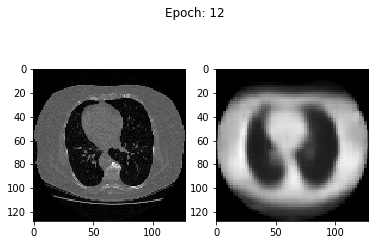

>11318, d1[0.844] d2[6.791] g[2.020]
>11319, d1[0.844] d2[6.791] g[2.241]
>11320, d1[0.844] d2[6.791] g[2.161]
>11321, d1[0.844] d2[6.791] g[3.287]
>11322, d1[0.844] d2[6.791] g[2.431]
>11323, d1[0.844] d2[6.791] g[2.472]
>11324, d1[0.844] d2[6.791] g[2.719]
>11325, d1[0.844] d2[6.791] g[2.311]
>11326, d1[0.844] d2[6.791] g[2.264]
>11327, d1[0.844] d2[6.791] g[2.705]
>11328, d1[0.844] d2[6.791] g[2.050]
>11329, d1[0.844] d2[6.791] g[2.360]
>11330, d1[0.844] d2[6.791] g[2.901]
>11331, d1[0.844] d2[6.791] g[2.526]
>11332, d1[0.844] d2[6.791] g[2.584]
>11333, d1[0.844] d2[6.791] g[2.294]
>11334, d1[0.844] d2[6.791] g[2.060]
>11335, d1[0.844] d2[6.791] g[2.043]
>11336, d1[0.844] d2[6.791] g[2.077]
>11337, d1[0.844] d2[6.791] g[2.236]
>11338, d1[0.844] d2[6.791] g[2.027]
>11339, d1[0.844] d2[6.791] g[2.386]
>11340, d1[0.844] d2[6.791] g[2.342]
>11341, d1[0.844] d2[6.791] g[3.004]
>11342, d1[0.844] d2[6.791] g[3.208]
>11343, d1[0.844] d2[6.791] g[2.609]
>11344, d1[0.844] d2[6.791] g[2.625]
>

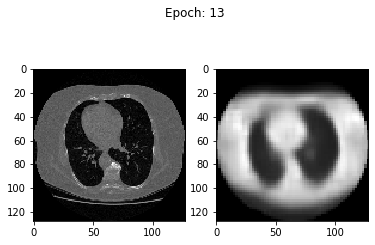

>12261, d1[0.844] d2[6.791] g[2.239]
>12262, d1[0.844] d2[6.791] g[2.002]
>12263, d1[0.844] d2[6.791] g[2.297]
>12264, d1[0.844] d2[6.791] g[2.294]
>12265, d1[0.844] d2[6.791] g[2.449]
>12266, d1[0.844] d2[6.791] g[2.507]
>12267, d1[0.844] d2[6.791] g[2.007]
>12268, d1[0.844] d2[6.791] g[2.333]
>12269, d1[0.844] d2[6.791] g[2.523]
>12270, d1[0.844] d2[6.791] g[2.053]
>12271, d1[0.844] d2[6.791] g[2.308]
>12272, d1[0.844] d2[6.791] g[2.222]
>12273, d1[0.844] d2[6.791] g[2.246]
>12274, d1[0.844] d2[6.791] g[2.185]
>12275, d1[0.844] d2[6.791] g[2.580]
>12276, d1[0.844] d2[6.791] g[2.181]
>12277, d1[0.844] d2[6.791] g[2.101]
>12278, d1[0.844] d2[6.791] g[2.644]
>12279, d1[0.844] d2[6.791] g[2.552]
>12280, d1[0.844] d2[6.791] g[3.001]
>12281, d1[0.844] d2[6.791] g[2.203]
>12282, d1[0.844] d2[6.791] g[2.683]
>12283, d1[0.844] d2[6.791] g[2.869]
>12284, d1[0.844] d2[6.791] g[2.648]
>12285, d1[0.844] d2[6.791] g[1.988]
>12286, d1[0.844] d2[6.791] g[2.144]
>12287, d1[0.844] d2[6.791] g[2.499]
>

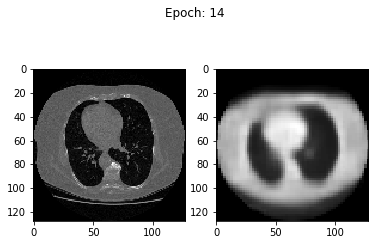

>13204, d1[0.844] d2[6.791] g[2.255]
>13205, d1[0.844] d2[6.791] g[2.232]
>13206, d1[0.844] d2[6.791] g[2.391]
>13207, d1[0.844] d2[6.791] g[2.036]
>13208, d1[0.844] d2[6.791] g[2.814]
>13209, d1[0.844] d2[6.791] g[2.794]
>13210, d1[0.844] d2[6.791] g[2.137]
>13211, d1[0.844] d2[6.791] g[2.218]
>13212, d1[0.844] d2[6.791] g[2.029]
>13213, d1[0.844] d2[6.791] g[2.072]
>13214, d1[0.844] d2[6.791] g[2.503]
>13215, d1[0.844] d2[6.791] g[2.439]
>13216, d1[0.844] d2[6.791] g[2.624]
>13217, d1[0.844] d2[6.791] g[2.063]
>13218, d1[0.844] d2[6.791] g[2.114]
>13219, d1[0.844] d2[6.791] g[2.441]
>13220, d1[0.844] d2[6.791] g[2.238]
>13221, d1[0.844] d2[6.791] g[2.079]
>13222, d1[0.844] d2[6.791] g[2.026]
>13223, d1[0.844] d2[6.791] g[2.476]
>13224, d1[0.844] d2[6.791] g[2.324]
>13225, d1[0.844] d2[6.791] g[2.352]
>13226, d1[0.844] d2[6.791] g[2.023]
>13227, d1[0.844] d2[6.791] g[2.115]
>13228, d1[0.844] d2[6.791] g[2.446]
>13229, d1[0.844] d2[6.791] g[2.155]
>13230, d1[0.844] d2[6.791] g[2.224]
>

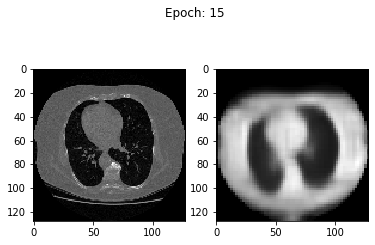

>14147, d1[0.844] d2[6.791] g[2.640]
>14148, d1[0.844] d2[6.791] g[2.553]
>14149, d1[0.844] d2[6.791] g[2.573]
>14150, d1[0.844] d2[6.791] g[2.222]
>14151, d1[0.844] d2[6.791] g[2.324]
>14152, d1[0.844] d2[6.791] g[2.478]
>14153, d1[0.844] d2[6.791] g[2.112]
>14154, d1[0.844] d2[6.791] g[2.089]
>14155, d1[0.844] d2[6.791] g[2.574]
>14156, d1[0.844] d2[6.791] g[2.243]
>14157, d1[0.844] d2[6.791] g[2.555]
>14158, d1[0.844] d2[6.791] g[1.990]
>14159, d1[0.844] d2[6.791] g[2.052]
>14160, d1[0.844] d2[6.791] g[2.100]
>14161, d1[0.844] d2[6.791] g[2.303]
>14162, d1[0.844] d2[6.791] g[1.969]
>14163, d1[0.844] d2[6.791] g[2.444]
>14164, d1[0.844] d2[6.791] g[3.064]
>14165, d1[0.844] d2[6.791] g[2.211]
>14166, d1[0.844] d2[6.791] g[2.341]
>14167, d1[0.844] d2[6.791] g[2.149]
>14168, d1[0.844] d2[6.791] g[2.658]
>14169, d1[0.844] d2[6.791] g[2.075]
>14170, d1[0.844] d2[6.791] g[2.250]
>14171, d1[0.844] d2[6.791] g[2.490]
>14172, d1[0.844] d2[6.791] g[2.577]
>14173, d1[0.844] d2[6.791] g[2.236]
>

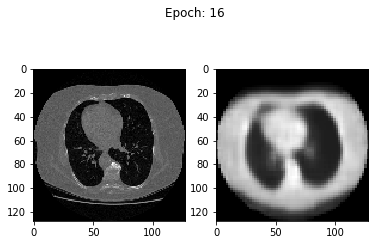

>15090, d1[0.844] d2[6.791] g[2.417]
>15091, d1[0.844] d2[6.791] g[2.378]
>15092, d1[0.844] d2[6.791] g[2.187]
>15093, d1[0.844] d2[6.791] g[2.319]
>15094, d1[0.844] d2[6.791] g[2.134]
>15095, d1[0.844] d2[6.791] g[2.156]
>15096, d1[0.844] d2[6.791] g[2.401]
>15097, d1[0.844] d2[6.791] g[2.522]
>15098, d1[0.844] d2[6.791] g[2.103]
>15099, d1[0.844] d2[6.791] g[2.691]
>15100, d1[0.844] d2[6.791] g[2.018]
>15101, d1[0.844] d2[6.791] g[2.153]
>15102, d1[0.844] d2[6.791] g[2.807]
>15103, d1[0.844] d2[6.791] g[2.056]
>15104, d1[0.844] d2[6.791] g[1.982]
>15105, d1[0.844] d2[6.791] g[1.920]
>15106, d1[0.844] d2[6.791] g[2.098]
>15107, d1[0.844] d2[6.791] g[2.045]
>15108, d1[0.844] d2[6.791] g[2.471]
>15109, d1[0.844] d2[6.791] g[2.199]
>15110, d1[0.844] d2[6.791] g[2.146]
>15111, d1[0.844] d2[6.791] g[2.704]
>15112, d1[0.844] d2[6.791] g[2.048]
>15113, d1[0.844] d2[6.791] g[2.258]
>15114, d1[0.844] d2[6.791] g[2.496]
>15115, d1[0.844] d2[6.791] g[2.588]
>15116, d1[0.844] d2[6.791] g[2.264]
>

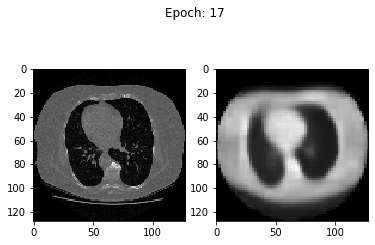

>16033, d1[0.844] d2[6.791] g[2.344]
>16034, d1[0.844] d2[6.791] g[2.044]
>16035, d1[0.844] d2[6.791] g[2.248]
>16036, d1[0.844] d2[6.791] g[2.199]
>16037, d1[0.844] d2[6.791] g[1.945]
>16038, d1[0.844] d2[6.791] g[2.053]
>16039, d1[0.844] d2[6.791] g[2.485]
>16040, d1[0.844] d2[6.791] g[2.144]
>16041, d1[0.844] d2[6.791] g[2.446]
>16042, d1[0.844] d2[6.791] g[2.102]
>16043, d1[0.844] d2[6.791] g[2.136]
>16044, d1[0.844] d2[6.791] g[2.048]
>16045, d1[0.844] d2[6.791] g[2.144]
>16046, d1[0.844] d2[6.791] g[2.084]
>16047, d1[0.844] d2[6.791] g[2.368]
>16048, d1[0.844] d2[6.791] g[2.793]
>16049, d1[0.844] d2[6.791] g[2.113]
>16050, d1[0.844] d2[6.791] g[2.119]
>16051, d1[0.844] d2[6.791] g[2.000]
>16052, d1[0.844] d2[6.791] g[2.067]
>16053, d1[0.844] d2[6.791] g[2.495]
>16054, d1[0.844] d2[6.791] g[1.970]
>16055, d1[0.844] d2[6.791] g[2.123]
>16056, d1[0.844] d2[6.791] g[2.107]
>16057, d1[0.844] d2[6.791] g[1.961]
>16058, d1[0.844] d2[6.791] g[2.111]
>16059, d1[0.844] d2[6.791] g[2.073]
>

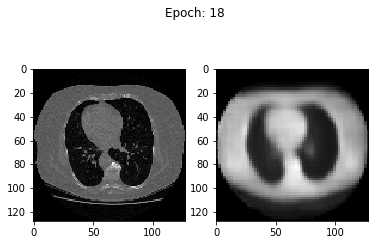

>16976, d1[0.844] d2[6.791] g[2.046]
>16977, d1[0.844] d2[6.791] g[2.071]
>16978, d1[0.844] d2[6.791] g[2.304]
>16979, d1[0.844] d2[6.791] g[2.250]
>16980, d1[0.844] d2[6.791] g[2.589]
>16981, d1[0.844] d2[6.791] g[2.475]
>16982, d1[0.844] d2[6.791] g[1.976]
>16983, d1[0.844] d2[6.791] g[2.048]
>16984, d1[0.844] d2[6.791] g[2.055]
>16985, d1[0.844] d2[6.791] g[2.025]
>16986, d1[0.844] d2[6.791] g[2.085]
>16987, d1[0.844] d2[6.791] g[2.250]
>16988, d1[0.844] d2[6.791] g[2.037]
>16989, d1[0.844] d2[6.791] g[2.135]
>16990, d1[0.844] d2[6.791] g[2.412]
>16991, d1[0.844] d2[6.791] g[2.241]
>16992, d1[0.844] d2[6.791] g[2.029]
>16993, d1[0.844] d2[6.791] g[2.315]
>16994, d1[0.844] d2[6.791] g[2.225]
>16995, d1[0.844] d2[6.791] g[2.064]
>16996, d1[0.844] d2[6.791] g[2.456]
>16997, d1[0.844] d2[6.791] g[2.229]
>16998, d1[0.844] d2[6.791] g[1.964]
>16999, d1[0.844] d2[6.791] g[2.372]
>17000, d1[0.844] d2[6.791] g[2.307]
>17001, d1[0.844] d2[6.791] g[2.119]
>17002, d1[0.844] d2[6.791] g[2.110]
>

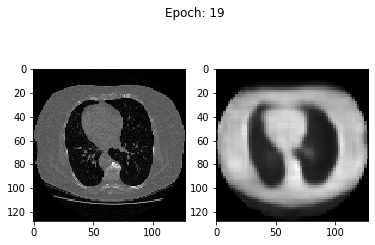

>17919, d1[0.844] d2[6.791] g[2.075]
>17920, d1[0.844] d2[6.791] g[1.900]
>17921, d1[0.844] d2[6.791] g[2.134]
>17922, d1[0.844] d2[6.791] g[1.972]
>17923, d1[0.844] d2[6.791] g[2.165]
>17924, d1[0.844] d2[6.791] g[1.994]
>17925, d1[0.844] d2[6.791] g[2.434]
>17926, d1[0.844] d2[6.791] g[2.004]
>17927, d1[0.844] d2[6.791] g[2.343]
>17928, d1[0.844] d2[6.791] g[2.144]
>17929, d1[0.844] d2[6.791] g[2.301]
>17930, d1[0.844] d2[6.791] g[2.432]
>17931, d1[0.844] d2[6.791] g[2.312]
>17932, d1[0.844] d2[6.791] g[2.599]
>17933, d1[0.844] d2[6.791] g[2.477]
>17934, d1[0.844] d2[6.791] g[2.076]
>17935, d1[0.844] d2[6.791] g[2.813]
>17936, d1[0.844] d2[6.791] g[2.441]
>17937, d1[0.844] d2[6.791] g[2.209]
>17938, d1[0.844] d2[6.791] g[2.050]
>17939, d1[0.844] d2[6.791] g[2.255]
>17940, d1[0.844] d2[6.791] g[2.167]
>17941, d1[0.844] d2[6.791] g[2.213]
>17942, d1[0.844] d2[6.791] g[1.940]
>17943, d1[0.844] d2[6.791] g[2.436]
>17944, d1[0.844] d2[6.791] g[2.223]
>17945, d1[0.844] d2[6.791] g[2.208]
>

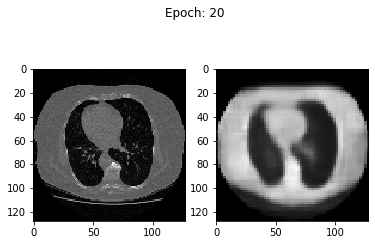

>18862, d1[0.844] d2[6.791] g[2.328]
>18863, d1[0.844] d2[6.791] g[2.258]
>18864, d1[0.844] d2[6.791] g[1.949]
>18865, d1[0.844] d2[6.791] g[2.000]
>18866, d1[0.844] d2[6.791] g[2.144]
>18867, d1[0.844] d2[6.791] g[2.226]
>18868, d1[0.844] d2[6.791] g[2.688]
>18869, d1[0.844] d2[6.791] g[2.016]
>18870, d1[0.844] d2[6.791] g[2.024]
>18871, d1[0.844] d2[6.791] g[2.126]
>18872, d1[0.844] d2[6.791] g[2.242]
>18873, d1[0.844] d2[6.791] g[2.094]
>18874, d1[0.844] d2[6.791] g[2.503]
>18875, d1[0.844] d2[6.791] g[2.125]
>18876, d1[0.844] d2[6.791] g[2.215]
>18877, d1[0.844] d2[6.791] g[2.052]
>18878, d1[0.844] d2[6.791] g[2.026]
>18879, d1[0.844] d2[6.791] g[2.138]
>18880, d1[0.844] d2[6.791] g[2.170]
>18881, d1[0.844] d2[6.791] g[2.127]
>18882, d1[0.844] d2[6.791] g[2.001]
>18883, d1[0.844] d2[6.791] g[2.152]
>18884, d1[0.844] d2[6.791] g[2.099]
>18885, d1[0.844] d2[6.791] g[2.535]
>18886, d1[0.844] d2[6.791] g[2.317]
>18887, d1[0.844] d2[6.791] g[2.066]
>18888, d1[0.844] d2[6.791] g[2.352]
>

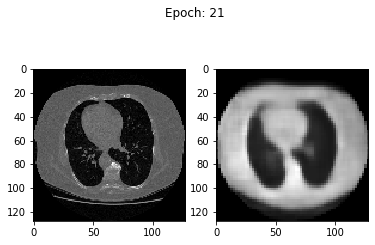

>19805, d1[0.844] d2[6.791] g[2.198]
>19806, d1[0.844] d2[6.791] g[2.211]
>19807, d1[0.844] d2[6.791] g[1.999]
>19808, d1[0.844] d2[6.791] g[2.313]
>19809, d1[0.844] d2[6.791] g[2.089]
>19810, d1[0.844] d2[6.791] g[1.953]
>19811, d1[0.844] d2[6.791] g[2.258]
>19812, d1[0.844] d2[6.791] g[2.131]
>19813, d1[0.844] d2[6.791] g[2.333]
>19814, d1[0.844] d2[6.791] g[2.568]
>19815, d1[0.844] d2[6.791] g[2.165]
>19816, d1[0.844] d2[6.791] g[2.445]
>19817, d1[0.844] d2[6.791] g[2.068]
>19818, d1[0.844] d2[6.791] g[2.044]
>19819, d1[0.844] d2[6.791] g[2.001]
>19820, d1[0.844] d2[6.791] g[1.915]
>19821, d1[0.844] d2[6.791] g[2.349]
>19822, d1[0.844] d2[6.791] g[2.219]
>19823, d1[0.844] d2[6.791] g[2.372]
>19824, d1[0.844] d2[6.791] g[2.024]
>19825, d1[0.844] d2[6.791] g[1.970]
>19826, d1[0.844] d2[6.791] g[2.057]
>19827, d1[0.844] d2[6.791] g[2.180]
>19828, d1[0.844] d2[6.791] g[2.356]
>19829, d1[0.844] d2[6.791] g[2.236]
>19830, d1[0.844] d2[6.791] g[2.254]
>19831, d1[0.844] d2[6.791] g[2.335]
>

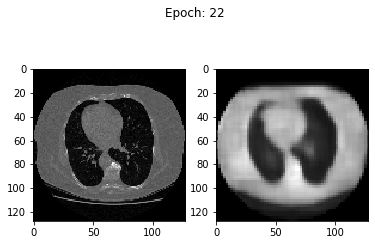

>20748, d1[0.844] d2[6.791] g[1.885]
>20749, d1[0.844] d2[6.791] g[1.958]
>20750, d1[0.844] d2[6.791] g[2.148]
>20751, d1[0.844] d2[6.791] g[2.258]
>20752, d1[0.844] d2[6.791] g[2.252]
>20753, d1[0.844] d2[6.791] g[1.964]
>20754, d1[0.844] d2[6.791] g[1.958]
>20755, d1[0.844] d2[6.791] g[2.224]
>20756, d1[0.844] d2[6.791] g[2.184]
>20757, d1[0.844] d2[6.791] g[1.950]
>20758, d1[0.844] d2[6.791] g[2.133]
>20759, d1[0.844] d2[6.791] g[1.948]
>20760, d1[0.844] d2[6.791] g[2.262]
>20761, d1[0.844] d2[6.791] g[2.174]
>20762, d1[0.844] d2[6.791] g[2.262]
>20763, d1[0.844] d2[6.791] g[2.027]
>20764, d1[0.844] d2[6.791] g[2.107]
>20765, d1[0.844] d2[6.791] g[1.997]
>20766, d1[0.844] d2[6.791] g[2.092]
>20767, d1[0.844] d2[6.791] g[1.969]
>20768, d1[0.844] d2[6.791] g[2.168]
>20769, d1[0.844] d2[6.791] g[2.553]
>20770, d1[0.844] d2[6.791] g[2.147]
>20771, d1[0.844] d2[6.791] g[2.038]
>20772, d1[0.844] d2[6.791] g[2.314]
>20773, d1[0.844] d2[6.791] g[2.011]
>20774, d1[0.844] d2[6.791] g[2.147]
>

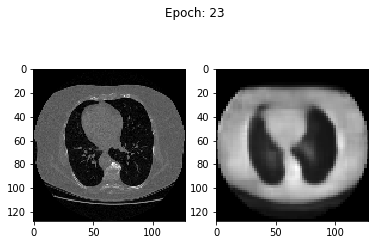

>21691, d1[0.844] d2[6.791] g[2.280]
>21692, d1[0.844] d2[6.791] g[2.006]
>21693, d1[0.844] d2[6.791] g[1.910]
>21694, d1[0.844] d2[6.791] g[2.241]
>21695, d1[0.844] d2[6.791] g[2.014]
>21696, d1[0.844] d2[6.791] g[2.233]
>21697, d1[0.844] d2[6.791] g[1.962]
>21698, d1[0.844] d2[6.791] g[2.249]
>21699, d1[0.844] d2[6.791] g[2.289]
>21700, d1[0.844] d2[6.791] g[2.056]
>21701, d1[0.844] d2[6.791] g[2.036]
>21702, d1[0.844] d2[6.791] g[2.183]
>21703, d1[0.844] d2[6.791] g[2.277]
>21704, d1[0.844] d2[6.791] g[2.172]
>21705, d1[0.844] d2[6.791] g[2.042]
>21706, d1[0.844] d2[6.791] g[2.326]
>21707, d1[0.844] d2[6.791] g[1.905]
>21708, d1[0.844] d2[6.791] g[2.201]
>21709, d1[0.844] d2[6.791] g[2.220]
>21710, d1[0.844] d2[6.791] g[1.992]
>21711, d1[0.844] d2[6.791] g[1.982]
>21712, d1[0.844] d2[6.791] g[2.154]
>21713, d1[0.844] d2[6.791] g[2.337]
>21714, d1[0.844] d2[6.791] g[2.033]
>21715, d1[0.844] d2[6.791] g[2.117]
>21716, d1[0.844] d2[6.791] g[2.061]
>21717, d1[0.844] d2[6.791] g[2.325]
>

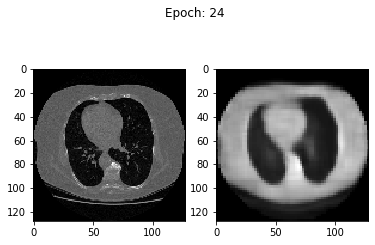

>22634, d1[0.844] d2[6.791] g[2.160]
>22635, d1[0.844] d2[6.791] g[2.135]
>22636, d1[0.844] d2[6.791] g[2.051]
>22637, d1[0.844] d2[6.791] g[2.111]
>22638, d1[0.844] d2[6.791] g[2.196]
>22639, d1[0.844] d2[6.791] g[1.974]
>22640, d1[0.844] d2[6.791] g[2.203]
>22641, d1[0.844] d2[6.791] g[1.978]
>22642, d1[0.844] d2[6.791] g[2.311]
>22643, d1[0.844] d2[6.791] g[2.144]
>22644, d1[0.844] d2[6.791] g[2.377]
>22645, d1[0.844] d2[6.791] g[1.970]
>22646, d1[0.844] d2[6.791] g[2.148]
>22647, d1[0.844] d2[6.791] g[1.968]
>22648, d1[0.844] d2[6.791] g[2.054]
>22649, d1[0.844] d2[6.791] g[3.002]
>22650, d1[0.844] d2[6.791] g[2.043]
>22651, d1[0.844] d2[6.791] g[2.037]
>22652, d1[0.844] d2[6.791] g[2.229]
>22653, d1[0.844] d2[6.791] g[2.040]
>22654, d1[0.844] d2[6.791] g[2.232]
>22655, d1[0.844] d2[6.791] g[2.232]
>22656, d1[0.844] d2[6.791] g[2.165]
>22657, d1[0.844] d2[6.791] g[2.036]
>22658, d1[0.844] d2[6.791] g[2.057]
>22659, d1[0.844] d2[6.791] g[2.069]
>22660, d1[0.844] d2[6.791] g[2.320]
>

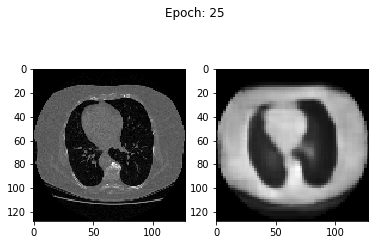

>23577, d1[0.844] d2[6.791] g[2.084]
>23578, d1[0.844] d2[6.791] g[2.061]
>23579, d1[0.844] d2[6.791] g[2.114]
>23580, d1[0.844] d2[6.791] g[2.051]
>23581, d1[0.844] d2[6.791] g[1.933]
>23582, d1[0.844] d2[6.791] g[1.952]
>23583, d1[0.844] d2[6.791] g[2.251]
>23584, d1[0.844] d2[6.791] g[2.202]
>23585, d1[0.844] d2[6.791] g[2.003]
>23586, d1[0.844] d2[6.791] g[2.221]
>23587, d1[0.844] d2[6.791] g[2.346]
>23588, d1[0.844] d2[6.791] g[1.935]
>23589, d1[0.844] d2[6.791] g[2.200]
>23590, d1[0.844] d2[6.791] g[2.172]
>23591, d1[0.844] d2[6.791] g[2.025]
>23592, d1[0.844] d2[6.791] g[2.251]
>23593, d1[0.844] d2[6.791] g[2.297]
>23594, d1[0.844] d2[6.791] g[2.030]
>23595, d1[0.844] d2[6.791] g[2.228]
>23596, d1[0.844] d2[6.791] g[2.037]
>23597, d1[0.844] d2[6.791] g[2.233]
>23598, d1[0.844] d2[6.791] g[1.936]
>23599, d1[0.844] d2[6.791] g[2.161]
>23600, d1[0.844] d2[6.791] g[2.439]
>23601, d1[0.844] d2[6.791] g[2.287]
>23602, d1[0.844] d2[6.791] g[1.921]
>23603, d1[0.844] d2[6.791] g[2.234]
>

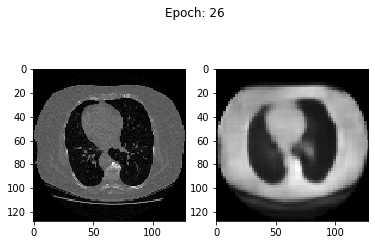

>24520, d1[0.844] d2[6.791] g[2.233]
>24521, d1[0.844] d2[6.791] g[2.008]
>24522, d1[0.844] d2[6.791] g[2.139]
>24523, d1[0.844] d2[6.791] g[2.125]
>24524, d1[0.844] d2[6.791] g[1.952]
>24525, d1[0.844] d2[6.791] g[2.377]
>24526, d1[0.844] d2[6.791] g[1.909]
>24527, d1[0.844] d2[6.791] g[2.378]
>24528, d1[0.844] d2[6.791] g[2.081]
>24529, d1[0.844] d2[6.791] g[1.962]
>24530, d1[0.844] d2[6.791] g[2.009]
>24531, d1[0.844] d2[6.791] g[2.267]
>24532, d1[0.844] d2[6.791] g[1.983]
>24533, d1[0.844] d2[6.791] g[2.165]
>24534, d1[0.844] d2[6.791] g[2.163]
>24535, d1[0.844] d2[6.791] g[2.227]
>24536, d1[0.844] d2[6.791] g[1.978]
>24537, d1[0.844] d2[6.791] g[2.071]
>24538, d1[0.844] d2[6.791] g[2.109]
>24539, d1[0.844] d2[6.791] g[2.064]
>24540, d1[0.844] d2[6.791] g[1.991]
>24541, d1[0.844] d2[6.791] g[2.642]
>24542, d1[0.844] d2[6.791] g[2.208]
>24543, d1[0.844] d2[6.791] g[1.935]
>24544, d1[0.844] d2[6.791] g[2.042]
>24545, d1[0.844] d2[6.791] g[2.161]
>24546, d1[0.844] d2[6.791] g[2.193]
>

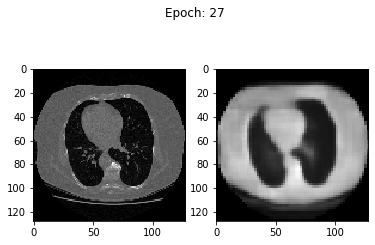

>25463, d1[0.844] d2[6.791] g[2.129]
>25464, d1[0.844] d2[6.791] g[2.537]
>25465, d1[0.844] d2[6.791] g[1.989]
>25466, d1[0.844] d2[6.791] g[2.334]
>25467, d1[0.844] d2[6.791] g[2.079]
>25468, d1[0.844] d2[6.791] g[2.156]
>25469, d1[0.844] d2[6.791] g[1.997]
>25470, d1[0.844] d2[6.791] g[2.234]
>25471, d1[0.844] d2[6.791] g[2.136]
>25472, d1[0.844] d2[6.791] g[2.098]
>25473, d1[0.844] d2[6.791] g[1.904]
>25474, d1[0.844] d2[6.791] g[2.229]
>25475, d1[0.844] d2[6.791] g[2.236]
>25476, d1[0.844] d2[6.791] g[1.912]
>25477, d1[0.844] d2[6.791] g[2.031]
>25478, d1[0.844] d2[6.791] g[1.884]
>25479, d1[0.844] d2[6.791] g[2.001]
>25480, d1[0.844] d2[6.791] g[2.043]
>25481, d1[0.844] d2[6.791] g[2.065]
>25482, d1[0.844] d2[6.791] g[1.944]
>25483, d1[0.844] d2[6.791] g[1.865]
>25484, d1[0.844] d2[6.791] g[1.972]
>25485, d1[0.844] d2[6.791] g[2.270]
>25486, d1[0.844] d2[6.791] g[1.936]
>25487, d1[0.844] d2[6.791] g[2.002]
>25488, d1[0.844] d2[6.791] g[2.244]
>25489, d1[0.844] d2[6.791] g[1.984]
>

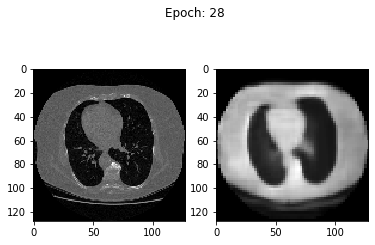

>26406, d1[0.844] d2[6.791] g[2.320]
>26407, d1[0.844] d2[6.791] g[2.089]
>26408, d1[0.844] d2[6.791] g[2.172]
>26409, d1[0.844] d2[6.791] g[1.952]
>26410, d1[0.844] d2[6.791] g[1.925]
>26411, d1[0.844] d2[6.791] g[2.399]
>26412, d1[0.844] d2[6.791] g[2.209]
>26413, d1[0.844] d2[6.791] g[2.018]
>26414, d1[0.844] d2[6.791] g[2.146]
>26415, d1[0.844] d2[6.791] g[2.262]
>26416, d1[0.844] d2[6.791] g[1.920]
>26417, d1[0.844] d2[6.791] g[2.064]
>26418, d1[0.844] d2[6.791] g[2.086]
>26419, d1[0.844] d2[6.791] g[2.234]
>26420, d1[0.844] d2[6.791] g[2.184]
>26421, d1[0.844] d2[6.791] g[2.224]
>26422, d1[0.844] d2[6.791] g[2.070]
>26423, d1[0.844] d2[6.791] g[1.948]
>26424, d1[0.844] d2[6.791] g[1.947]
>26425, d1[0.844] d2[6.791] g[2.060]
>26426, d1[0.844] d2[6.791] g[2.160]
>26427, d1[0.844] d2[6.791] g[2.215]
>26428, d1[0.844] d2[6.791] g[2.079]
>26429, d1[0.844] d2[6.791] g[2.260]
>26430, d1[0.844] d2[6.791] g[2.020]
>26431, d1[0.844] d2[6.791] g[2.158]
>26432, d1[0.844] d2[6.791] g[2.093]
>

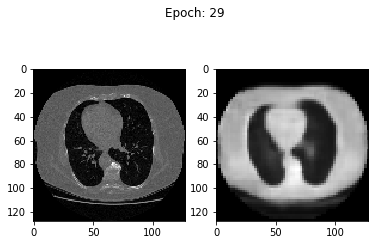

>27349, d1[0.844] d2[6.791] g[2.238]
>27350, d1[0.844] d2[6.791] g[2.259]
>27351, d1[0.844] d2[6.791] g[2.010]
>27352, d1[0.844] d2[6.791] g[2.159]
>27353, d1[0.844] d2[6.791] g[1.916]
>27354, d1[0.844] d2[6.791] g[2.015]
>27355, d1[0.844] d2[6.791] g[1.985]
>27356, d1[0.844] d2[6.791] g[2.196]
>27357, d1[0.844] d2[6.791] g[2.096]
>27358, d1[0.844] d2[6.791] g[1.915]
>27359, d1[0.844] d2[6.791] g[2.046]
>27360, d1[0.844] d2[6.791] g[1.893]
>27361, d1[0.844] d2[6.791] g[1.933]
>27362, d1[0.844] d2[6.791] g[2.051]
>27363, d1[0.844] d2[6.791] g[1.973]
>27364, d1[0.844] d2[6.791] g[2.108]
>27365, d1[0.844] d2[6.791] g[2.107]
>27366, d1[0.844] d2[6.791] g[1.914]
>27367, d1[0.844] d2[6.791] g[2.235]
>27368, d1[0.844] d2[6.791] g[1.931]
>27369, d1[0.844] d2[6.791] g[2.082]
>27370, d1[0.844] d2[6.791] g[2.333]
>27371, d1[0.844] d2[6.791] g[1.910]
>27372, d1[0.844] d2[6.791] g[1.999]
>27373, d1[0.844] d2[6.791] g[1.947]
>27374, d1[0.844] d2[6.791] g[2.171]
>27375, d1[0.844] d2[6.791] g[2.313]
>

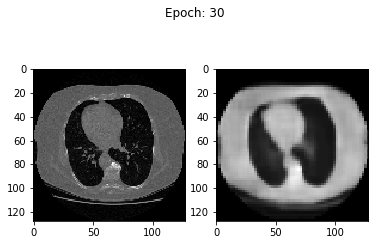

>28292, d1[0.844] d2[6.791] g[2.112]
>28293, d1[0.844] d2[6.791] g[2.042]
>28294, d1[0.844] d2[6.791] g[1.920]
>28295, d1[0.844] d2[6.791] g[1.936]
>28296, d1[0.844] d2[6.791] g[1.959]
>28297, d1[0.844] d2[6.791] g[2.095]
>28298, d1[0.844] d2[6.791] g[2.120]
>28299, d1[0.844] d2[6.791] g[1.924]
>28300, d1[0.844] d2[6.791] g[2.091]
>28301, d1[0.844] d2[6.791] g[2.137]
>28302, d1[0.844] d2[6.791] g[1.990]
>28303, d1[0.844] d2[6.791] g[1.921]
>28304, d1[0.844] d2[6.791] g[2.126]
>28305, d1[0.844] d2[6.791] g[1.976]
>28306, d1[0.844] d2[6.791] g[2.122]
>28307, d1[0.844] d2[6.791] g[1.959]
>28308, d1[0.844] d2[6.791] g[1.999]
>28309, d1[0.844] d2[6.791] g[2.191]
>28310, d1[0.844] d2[6.791] g[2.025]
>28311, d1[0.844] d2[6.791] g[2.029]
>28312, d1[0.844] d2[6.791] g[1.977]
>28313, d1[0.844] d2[6.791] g[1.952]
>28314, d1[0.844] d2[6.791] g[2.113]
>28315, d1[0.844] d2[6.791] g[2.070]
>28316, d1[0.844] d2[6.791] g[1.902]
>28317, d1[0.844] d2[6.791] g[2.059]
>28318, d1[0.844] d2[6.791] g[1.956]
>

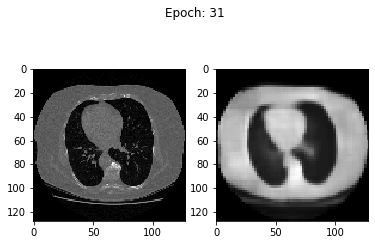

>29235, d1[0.844] d2[6.791] g[1.965]
>29236, d1[0.844] d2[6.791] g[2.226]
>29237, d1[0.844] d2[6.791] g[1.974]
>29238, d1[0.844] d2[6.791] g[1.907]
>29239, d1[0.844] d2[6.791] g[2.145]
>29240, d1[0.844] d2[6.791] g[2.259]
>29241, d1[0.844] d2[6.791] g[1.900]
>29242, d1[0.844] d2[6.791] g[2.136]
>29243, d1[0.844] d2[6.791] g[1.954]
>29244, d1[0.844] d2[6.791] g[2.194]
>29245, d1[0.844] d2[6.791] g[1.958]
>29246, d1[0.844] d2[6.791] g[2.136]
>29247, d1[0.844] d2[6.791] g[1.952]
>29248, d1[0.844] d2[6.791] g[1.944]
>29249, d1[0.844] d2[6.791] g[2.267]
>29250, d1[0.844] d2[6.791] g[1.927]
>29251, d1[0.844] d2[6.791] g[2.483]
>29252, d1[0.844] d2[6.791] g[2.103]
>29253, d1[0.844] d2[6.791] g[2.067]
>29254, d1[0.844] d2[6.791] g[2.142]
>29255, d1[0.844] d2[6.791] g[2.052]
>29256, d1[0.844] d2[6.791] g[2.048]
>29257, d1[0.844] d2[6.791] g[2.200]
>29258, d1[0.844] d2[6.791] g[2.066]
>29259, d1[0.844] d2[6.791] g[1.957]
>29260, d1[0.844] d2[6.791] g[2.209]
>29261, d1[0.844] d2[6.791] g[2.237]
>

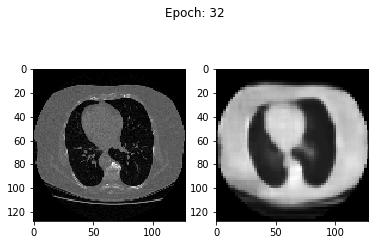

>30178, d1[0.844] d2[6.791] g[1.898]
>30179, d1[0.844] d2[6.791] g[2.106]
>30180, d1[0.844] d2[6.791] g[2.358]
>30181, d1[0.844] d2[6.791] g[2.115]
>30182, d1[0.844] d2[6.791] g[2.029]
>30183, d1[0.844] d2[6.791] g[1.947]
>30184, d1[0.844] d2[6.791] g[2.317]
>30185, d1[0.844] d2[6.791] g[2.201]
>30186, d1[0.844] d2[6.791] g[2.008]
>30187, d1[0.844] d2[6.791] g[2.168]
>30188, d1[0.844] d2[6.791] g[2.164]
>30189, d1[0.844] d2[6.791] g[2.033]
>30190, d1[0.844] d2[6.791] g[2.037]
>30191, d1[0.844] d2[6.791] g[2.009]
>30192, d1[0.844] d2[6.791] g[2.002]
>30193, d1[0.844] d2[6.791] g[2.186]
>30194, d1[0.844] d2[6.791] g[2.158]
>30195, d1[0.844] d2[6.791] g[1.956]
>30196, d1[0.844] d2[6.791] g[1.936]
>30197, d1[0.844] d2[6.791] g[2.087]
>30198, d1[0.844] d2[6.791] g[1.906]
>30199, d1[0.844] d2[6.791] g[1.896]
>30200, d1[0.844] d2[6.791] g[2.245]
>30201, d1[0.844] d2[6.791] g[2.057]
>30202, d1[0.844] d2[6.791] g[1.880]
>30203, d1[0.844] d2[6.791] g[1.980]
>30204, d1[0.844] d2[6.791] g[1.932]
>

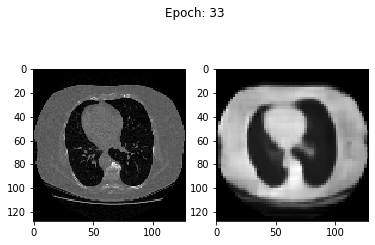

>31121, d1[0.844] d2[6.791] g[2.208]
>31122, d1[0.844] d2[6.791] g[2.110]
>31123, d1[0.844] d2[6.791] g[1.911]
>31124, d1[0.844] d2[6.791] g[2.020]
>31125, d1[0.844] d2[6.791] g[1.957]
>31126, d1[0.844] d2[6.791] g[2.111]
>31127, d1[0.844] d2[6.791] g[2.189]
>31128, d1[0.844] d2[6.791] g[1.931]
>31129, d1[0.844] d2[6.791] g[1.903]
>31130, d1[0.844] d2[6.791] g[1.863]
>31131, d1[0.844] d2[6.791] g[2.146]
>31132, d1[0.844] d2[6.791] g[1.995]
>31133, d1[0.844] d2[6.791] g[1.944]
>31134, d1[0.844] d2[6.791] g[2.146]
>31135, d1[0.844] d2[6.791] g[2.169]
>31136, d1[0.844] d2[6.791] g[2.117]
>31137, d1[0.844] d2[6.791] g[2.139]
>31138, d1[0.844] d2[6.791] g[2.061]
>31139, d1[0.844] d2[6.791] g[1.953]
>31140, d1[0.844] d2[6.791] g[2.031]
>31141, d1[0.844] d2[6.791] g[1.947]
>31142, d1[0.844] d2[6.791] g[2.158]
>31143, d1[0.844] d2[6.791] g[2.203]
>31144, d1[0.844] d2[6.791] g[2.274]
>31145, d1[0.844] d2[6.791] g[1.982]
>31146, d1[0.844] d2[6.791] g[2.009]
>31147, d1[0.844] d2[6.791] g[1.952]
>

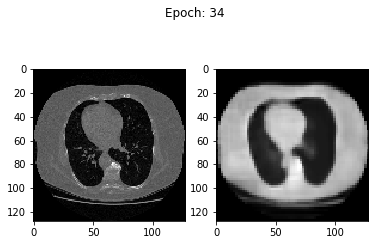

>32064, d1[0.844] d2[6.791] g[2.285]
>32065, d1[0.844] d2[6.791] g[1.927]
>32066, d1[0.844] d2[6.791] g[2.277]
>32067, d1[0.844] d2[6.791] g[2.188]
>32068, d1[0.844] d2[6.791] g[1.862]
>32069, d1[0.844] d2[6.791] g[1.948]
>32070, d1[0.844] d2[6.791] g[1.970]
>32071, d1[0.844] d2[6.791] g[1.877]
>32072, d1[0.844] d2[6.791] g[1.854]
>32073, d1[0.844] d2[6.791] g[1.956]
>32074, d1[0.844] d2[6.791] g[2.180]
>32075, d1[0.844] d2[6.791] g[1.927]
>32076, d1[0.844] d2[6.791] g[2.091]
>32077, d1[0.844] d2[6.791] g[1.926]
>32078, d1[0.844] d2[6.791] g[1.977]
>32079, d1[0.844] d2[6.791] g[1.963]
>32080, d1[0.844] d2[6.791] g[2.062]
>32081, d1[0.844] d2[6.791] g[2.136]
>32082, d1[0.844] d2[6.791] g[2.002]
>32083, d1[0.844] d2[6.791] g[1.900]
>32084, d1[0.844] d2[6.791] g[1.918]
>32085, d1[0.844] d2[6.791] g[1.960]
>32086, d1[0.844] d2[6.791] g[2.260]
>32087, d1[0.844] d2[6.791] g[1.915]
>32088, d1[0.844] d2[6.791] g[1.844]
>32089, d1[0.844] d2[6.791] g[2.028]
>32090, d1[0.844] d2[6.791] g[2.062]
>

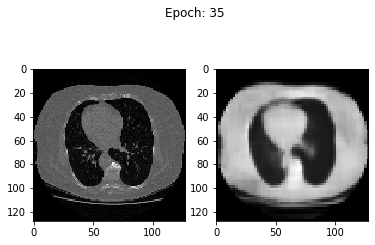

>33007, d1[0.844] d2[6.791] g[1.944]
>33008, d1[0.844] d2[6.791] g[1.887]
>33009, d1[0.844] d2[6.791] g[1.889]
>33010, d1[0.844] d2[6.791] g[2.235]
>33011, d1[0.844] d2[6.791] g[2.185]
>33012, d1[0.844] d2[6.791] g[2.230]
>33013, d1[0.844] d2[6.791] g[2.098]
>33014, d1[0.844] d2[6.791] g[2.073]
>33015, d1[0.844] d2[6.791] g[1.937]
>33016, d1[0.844] d2[6.791] g[2.161]
>33017, d1[0.844] d2[6.791] g[2.084]
>33018, d1[0.844] d2[6.791] g[1.881]
>33019, d1[0.844] d2[6.791] g[1.931]
>33020, d1[0.844] d2[6.791] g[1.977]
>33021, d1[0.844] d2[6.791] g[1.913]
>33022, d1[0.844] d2[6.791] g[1.936]
>33023, d1[0.844] d2[6.791] g[2.222]
>33024, d1[0.844] d2[6.791] g[1.894]
>33025, d1[0.844] d2[6.791] g[1.848]
>33026, d1[0.844] d2[6.791] g[1.963]
>33027, d1[0.844] d2[6.791] g[1.938]
>33028, d1[0.844] d2[6.791] g[1.991]
>33029, d1[0.844] d2[6.791] g[2.173]
>33030, d1[0.844] d2[6.791] g[2.169]
>33031, d1[0.844] d2[6.791] g[1.874]
>33032, d1[0.844] d2[6.791] g[2.187]
>33033, d1[0.844] d2[6.791] g[2.207]
>

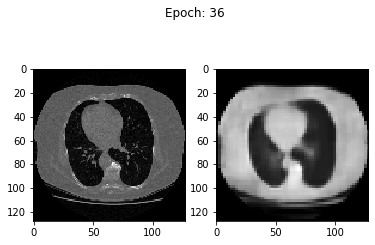

>33950, d1[0.844] d2[6.791] g[2.141]
>33951, d1[0.844] d2[6.791] g[1.919]
>33952, d1[0.844] d2[6.791] g[1.948]
>33953, d1[0.844] d2[6.791] g[1.918]
>33954, d1[0.844] d2[6.791] g[1.905]
>33955, d1[0.844] d2[6.791] g[2.098]
>33956, d1[0.844] d2[6.791] g[2.095]
>33957, d1[0.844] d2[6.791] g[2.003]
>33958, d1[0.844] d2[6.791] g[1.895]
>33959, d1[0.844] d2[6.791] g[2.073]
>33960, d1[0.844] d2[6.791] g[2.063]
>33961, d1[0.844] d2[6.791] g[1.933]
>33962, d1[0.844] d2[6.791] g[2.208]
>33963, d1[0.844] d2[6.791] g[1.990]
>33964, d1[0.844] d2[6.791] g[2.043]
>33965, d1[0.844] d2[6.791] g[2.067]
>33966, d1[0.844] d2[6.791] g[1.922]
>33967, d1[0.844] d2[6.791] g[1.925]
>33968, d1[0.844] d2[6.791] g[2.095]
>33969, d1[0.844] d2[6.791] g[2.036]
>33970, d1[0.844] d2[6.791] g[1.901]
>33971, d1[0.844] d2[6.791] g[1.896]
>33972, d1[0.844] d2[6.791] g[2.156]
>33973, d1[0.844] d2[6.791] g[1.950]
>33974, d1[0.844] d2[6.791] g[1.971]
>33975, d1[0.844] d2[6.791] g[1.938]
>33976, d1[0.844] d2[6.791] g[1.928]
>

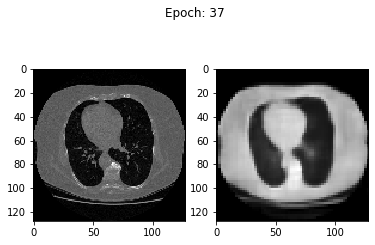

>34893, d1[0.844] d2[6.791] g[1.965]
>34894, d1[0.844] d2[6.791] g[1.924]
>34895, d1[0.844] d2[6.791] g[2.121]
>34896, d1[0.844] d2[6.791] g[2.104]
>34897, d1[0.844] d2[6.791] g[1.947]
>34898, d1[0.844] d2[6.791] g[2.075]
>34899, d1[0.844] d2[6.791] g[1.902]
>34900, d1[0.844] d2[6.791] g[2.125]
>34901, d1[0.844] d2[6.791] g[2.063]
>34902, d1[0.844] d2[6.791] g[2.107]
>34903, d1[0.844] d2[6.791] g[1.874]
>34904, d1[0.844] d2[6.791] g[2.169]
>34905, d1[0.844] d2[6.791] g[1.883]
>34906, d1[0.844] d2[6.791] g[1.882]
>34907, d1[0.844] d2[6.791] g[2.162]
>34908, d1[0.844] d2[6.791] g[1.965]
>34909, d1[0.844] d2[6.791] g[2.104]
>34910, d1[0.844] d2[6.791] g[1.868]
>34911, d1[0.844] d2[6.791] g[2.028]
>34912, d1[0.844] d2[6.791] g[2.132]
>34913, d1[0.844] d2[6.791] g[2.222]
>34914, d1[0.844] d2[6.791] g[2.090]
>34915, d1[0.844] d2[6.791] g[1.908]
>34916, d1[0.844] d2[6.791] g[1.944]
>34917, d1[0.844] d2[6.791] g[2.074]
>34918, d1[0.844] d2[6.791] g[2.126]
>34919, d1[0.844] d2[6.791] g[1.990]
>

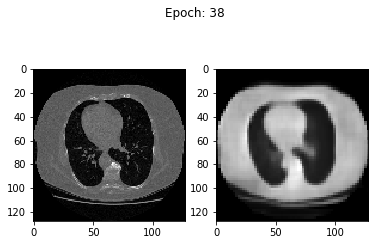

>35836, d1[0.844] d2[6.791] g[2.092]
>35837, d1[0.844] d2[6.791] g[2.102]
>35838, d1[0.844] d2[6.791] g[1.929]
>35839, d1[0.844] d2[6.791] g[2.155]
>35840, d1[0.844] d2[6.791] g[1.936]
>35841, d1[0.844] d2[6.791] g[1.904]
>35842, d1[0.844] d2[6.791] g[1.953]
>35843, d1[0.844] d2[6.791] g[2.145]
>35844, d1[0.844] d2[6.791] g[2.090]
>35845, d1[0.844] d2[6.791] g[1.885]
>35846, d1[0.844] d2[6.791] g[1.876]
>35847, d1[0.844] d2[6.791] g[1.865]
>35848, d1[0.844] d2[6.791] g[1.964]
>35849, d1[0.844] d2[6.791] g[1.876]
>35850, d1[0.844] d2[6.791] g[1.893]
>35851, d1[0.844] d2[6.791] g[2.028]
>35852, d1[0.844] d2[6.791] g[1.964]
>35853, d1[0.844] d2[6.791] g[2.063]
>35854, d1[0.844] d2[6.791] g[1.903]
>35855, d1[0.844] d2[6.791] g[2.084]
>35856, d1[0.844] d2[6.791] g[2.030]
>35857, d1[0.844] d2[6.791] g[2.232]
>35858, d1[0.844] d2[6.791] g[1.876]
>35859, d1[0.844] d2[6.791] g[2.081]
>35860, d1[0.844] d2[6.791] g[1.956]
>35861, d1[0.844] d2[6.791] g[2.060]
>35862, d1[0.844] d2[6.791] g[2.168]
>

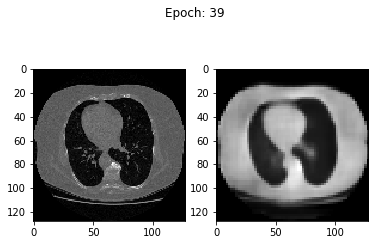

>36779, d1[0.844] d2[6.791] g[1.925]
>36780, d1[0.844] d2[6.791] g[1.960]
>36781, d1[0.844] d2[6.791] g[2.232]
>36782, d1[0.844] d2[6.791] g[1.833]
>36783, d1[0.844] d2[6.791] g[1.858]
>36784, d1[0.844] d2[6.791] g[1.971]
>36785, d1[0.844] d2[6.791] g[2.200]
>36786, d1[0.844] d2[6.791] g[1.884]
>36787, d1[0.844] d2[6.791] g[1.881]
>36788, d1[0.844] d2[6.791] g[2.122]
>36789, d1[0.844] d2[6.791] g[1.914]
>36790, d1[0.844] d2[6.791] g[2.202]
>36791, d1[0.844] d2[6.791] g[1.989]
>36792, d1[0.844] d2[6.791] g[2.129]
>36793, d1[0.844] d2[6.791] g[1.984]
>36794, d1[0.844] d2[6.791] g[2.109]
>36795, d1[0.844] d2[6.791] g[2.148]
>36796, d1[0.844] d2[6.791] g[1.865]
>36797, d1[0.844] d2[6.791] g[2.078]
>36798, d1[0.844] d2[6.791] g[2.156]
>36799, d1[0.844] d2[6.791] g[2.205]
>36800, d1[0.844] d2[6.791] g[2.106]
>36801, d1[0.844] d2[6.791] g[1.872]
>36802, d1[0.844] d2[6.791] g[1.905]
>36803, d1[0.844] d2[6.791] g[1.921]
>36804, d1[0.844] d2[6.791] g[2.163]
>36805, d1[0.844] d2[6.791] g[2.162]
>

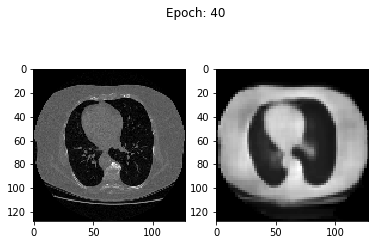

>37722, d1[0.844] d2[6.791] g[1.955]
>37723, d1[0.844] d2[6.791] g[1.935]
>37724, d1[0.844] d2[6.791] g[1.922]
>37725, d1[0.844] d2[6.791] g[2.194]
>37726, d1[0.844] d2[6.791] g[1.997]
>37727, d1[0.844] d2[6.791] g[1.860]
>37728, d1[0.844] d2[6.791] g[2.038]
>37729, d1[0.844] d2[6.791] g[2.384]
>37730, d1[0.844] d2[6.791] g[2.146]
>37731, d1[0.844] d2[6.791] g[1.864]
>37732, d1[0.844] d2[6.791] g[2.130]
>37733, d1[0.844] d2[6.791] g[2.167]
>37734, d1[0.844] d2[6.791] g[1.870]
>37735, d1[0.844] d2[6.791] g[1.914]
>37736, d1[0.844] d2[6.791] g[2.145]
>37737, d1[0.844] d2[6.791] g[1.906]
>37738, d1[0.844] d2[6.791] g[1.861]
>37739, d1[0.844] d2[6.791] g[2.124]
>37740, d1[0.844] d2[6.791] g[2.169]
>37741, d1[0.844] d2[6.791] g[2.002]
>37742, d1[0.844] d2[6.791] g[1.855]
>37743, d1[0.844] d2[6.791] g[1.859]
>37744, d1[0.844] d2[6.791] g[1.918]
>37745, d1[0.844] d2[6.791] g[2.133]
>37746, d1[0.844] d2[6.791] g[1.957]
>37747, d1[0.844] d2[6.791] g[2.074]
>37748, d1[0.844] d2[6.791] g[2.113]
>

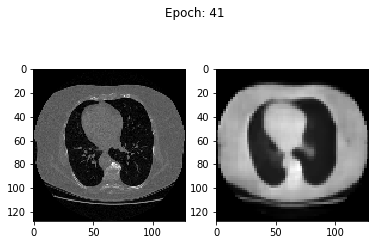

>38665, d1[0.844] d2[6.791] g[1.972]
>38666, d1[0.844] d2[6.791] g[1.919]
>38667, d1[0.844] d2[6.791] g[2.180]
>38668, d1[0.844] d2[6.791] g[1.910]
>38669, d1[0.844] d2[6.791] g[1.932]
>38670, d1[0.844] d2[6.791] g[1.887]
>38671, d1[0.844] d2[6.791] g[2.047]
>38672, d1[0.844] d2[6.791] g[1.865]
>38673, d1[0.844] d2[6.791] g[1.993]
>38674, d1[0.844] d2[6.791] g[2.127]
>38675, d1[0.844] d2[6.791] g[2.100]
>38676, d1[0.844] d2[6.791] g[1.892]
>38677, d1[0.844] d2[6.791] g[2.078]
>38678, d1[0.844] d2[6.791] g[1.837]
>38679, d1[0.844] d2[6.791] g[1.853]
>38680, d1[0.844] d2[6.791] g[2.109]
>38681, d1[0.844] d2[6.791] g[1.922]
>38682, d1[0.844] d2[6.791] g[2.077]
>38683, d1[0.844] d2[6.791] g[2.097]
>38684, d1[0.844] d2[6.791] g[2.126]
>38685, d1[0.844] d2[6.791] g[1.947]
>38686, d1[0.844] d2[6.791] g[1.875]
>38687, d1[0.844] d2[6.791] g[2.356]
>38688, d1[0.844] d2[6.791] g[2.110]
>38689, d1[0.844] d2[6.791] g[1.901]
>38690, d1[0.844] d2[6.791] g[1.842]
>38691, d1[0.844] d2[6.791] g[1.927]
>

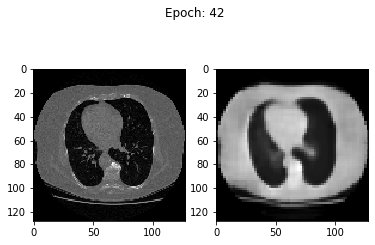

>39608, d1[0.844] d2[6.791] g[2.032]
>39609, d1[0.844] d2[6.791] g[1.969]
>39610, d1[0.844] d2[6.791] g[1.856]
>39611, d1[0.844] d2[6.791] g[1.860]
>39612, d1[0.844] d2[6.791] g[2.100]
>39613, d1[0.844] d2[6.791] g[2.029]
>39614, d1[0.844] d2[6.791] g[2.098]
>39615, d1[0.844] d2[6.791] g[2.069]
>39616, d1[0.844] d2[6.791] g[2.142]
>39617, d1[0.844] d2[6.791] g[2.093]
>39618, d1[0.844] d2[6.791] g[2.061]
>39619, d1[0.844] d2[6.791] g[2.364]
>39620, d1[0.844] d2[6.791] g[1.893]
>39621, d1[0.844] d2[6.791] g[2.158]
>39622, d1[0.844] d2[6.791] g[2.144]
>39623, d1[0.844] d2[6.791] g[2.082]
>39624, d1[0.844] d2[6.791] g[1.866]
>39625, d1[0.844] d2[6.791] g[1.917]
>39626, d1[0.844] d2[6.791] g[2.150]
>39627, d1[0.844] d2[6.791] g[2.129]
>39628, d1[0.844] d2[6.791] g[1.992]
>39629, d1[0.844] d2[6.791] g[1.922]
>39630, d1[0.844] d2[6.791] g[1.858]
>39631, d1[0.844] d2[6.791] g[2.008]
>39632, d1[0.844] d2[6.791] g[1.882]
>39633, d1[0.844] d2[6.791] g[1.953]
>39634, d1[0.844] d2[6.791] g[1.878]
>

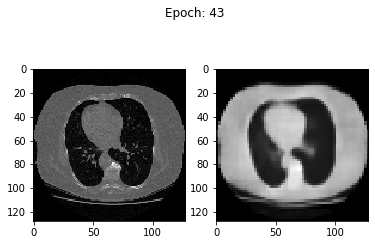

>40551, d1[0.844] d2[6.791] g[1.911]
>40552, d1[0.844] d2[6.791] g[1.861]
>40553, d1[0.844] d2[6.791] g[2.185]
>40554, d1[0.844] d2[6.791] g[2.163]
>40555, d1[0.844] d2[6.791] g[2.046]
>40556, d1[0.844] d2[6.791] g[1.885]
>40557, d1[0.844] d2[6.791] g[2.070]
>40558, d1[0.844] d2[6.791] g[2.002]
>40559, d1[0.844] d2[6.791] g[1.896]
>40560, d1[0.844] d2[6.791] g[1.950]
>40561, d1[0.844] d2[6.791] g[1.891]
>40562, d1[0.844] d2[6.791] g[1.885]
>40563, d1[0.844] d2[6.791] g[1.954]
>40564, d1[0.844] d2[6.791] g[2.031]
>40565, d1[0.844] d2[6.791] g[2.042]
>40566, d1[0.844] d2[6.791] g[2.123]
>40567, d1[0.844] d2[6.791] g[2.025]
>40568, d1[0.844] d2[6.791] g[2.055]
>40569, d1[0.844] d2[6.791] g[1.994]
>40570, d1[0.844] d2[6.791] g[1.856]
>40571, d1[0.844] d2[6.791] g[1.985]
>40572, d1[0.844] d2[6.791] g[2.000]
>40573, d1[0.844] d2[6.791] g[2.071]
>40574, d1[0.844] d2[6.791] g[1.858]
>40575, d1[0.844] d2[6.791] g[1.902]
>40576, d1[0.844] d2[6.791] g[1.874]
>40577, d1[0.844] d2[6.791] g[1.847]
>

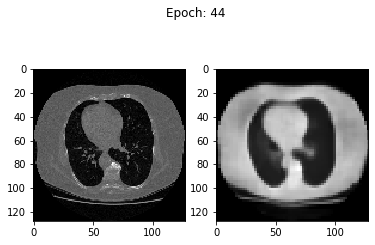

>41494, d1[0.844] d2[6.791] g[2.094]
>41495, d1[0.844] d2[6.791] g[1.891]
>41496, d1[0.844] d2[6.791] g[1.841]
>41497, d1[0.844] d2[6.791] g[2.083]
>41498, d1[0.844] d2[6.791] g[2.014]
>41499, d1[0.844] d2[6.791] g[2.071]
>41500, d1[0.844] d2[6.791] g[1.973]
>41501, d1[0.844] d2[6.791] g[2.091]
>41502, d1[0.844] d2[6.791] g[1.960]
>41503, d1[0.844] d2[6.791] g[1.861]
>41504, d1[0.844] d2[6.791] g[1.894]
>41505, d1[0.844] d2[6.791] g[2.141]
>41506, d1[0.844] d2[6.791] g[2.158]
>41507, d1[0.844] d2[6.791] g[1.939]
>41508, d1[0.844] d2[6.791] g[1.911]
>41509, d1[0.844] d2[6.791] g[2.034]
>41510, d1[0.844] d2[6.791] g[2.019]
>41511, d1[0.844] d2[6.791] g[2.009]
>41512, d1[0.844] d2[6.791] g[1.996]
>41513, d1[0.844] d2[6.791] g[2.075]
>41514, d1[0.844] d2[6.791] g[1.957]
>41515, d1[0.844] d2[6.791] g[1.837]
>41516, d1[0.844] d2[6.791] g[1.838]
>41517, d1[0.844] d2[6.791] g[2.052]
>41518, d1[0.844] d2[6.791] g[2.241]
>41519, d1[0.844] d2[6.791] g[1.979]
>41520, d1[0.844] d2[6.791] g[1.858]
>

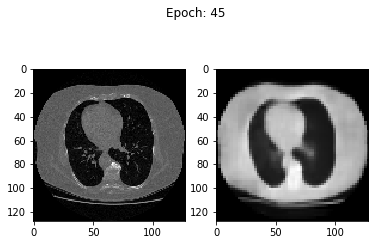

>42437, d1[0.844] d2[6.791] g[2.134]
>42438, d1[0.844] d2[6.791] g[1.910]
>42439, d1[0.844] d2[6.791] g[1.887]
>42440, d1[0.844] d2[6.791] g[1.856]
>42441, d1[0.844] d2[6.791] g[2.046]
>42442, d1[0.844] d2[6.791] g[2.082]
>42443, d1[0.844] d2[6.791] g[1.919]
>42444, d1[0.844] d2[6.791] g[2.139]
>42445, d1[0.844] d2[6.791] g[2.125]
>42446, d1[0.844] d2[6.791] g[1.985]
>42447, d1[0.844] d2[6.791] g[2.056]
>42448, d1[0.844] d2[6.791] g[2.138]
>42449, d1[0.844] d2[6.791] g[2.144]
>42450, d1[0.844] d2[6.791] g[1.863]
>42451, d1[0.844] d2[6.791] g[1.915]
>42452, d1[0.844] d2[6.791] g[1.901]
>42453, d1[0.844] d2[6.791] g[2.134]
>42454, d1[0.844] d2[6.791] g[2.159]
>42455, d1[0.844] d2[6.791] g[1.907]
>42456, d1[0.844] d2[6.791] g[1.888]
>42457, d1[0.844] d2[6.791] g[1.925]
>42458, d1[0.844] d2[6.791] g[1.834]
>42459, d1[0.844] d2[6.791] g[2.023]
>42460, d1[0.844] d2[6.791] g[1.918]
>42461, d1[0.844] d2[6.791] g[1.965]
>42462, d1[0.844] d2[6.791] g[2.110]
>42463, d1[0.844] d2[6.791] g[1.837]
>

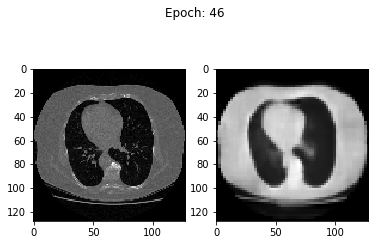

>43380, d1[0.844] d2[6.791] g[2.141]
>43381, d1[0.844] d2[6.791] g[2.047]
>43382, d1[0.844] d2[6.791] g[1.862]
>43383, d1[0.844] d2[6.791] g[2.020]
>43384, d1[0.844] d2[6.791] g[2.020]
>43385, d1[0.844] d2[6.791] g[1.911]
>43386, d1[0.844] d2[6.791] g[2.061]
>43387, d1[0.844] d2[6.791] g[1.889]
>43388, d1[0.844] d2[6.791] g[1.870]
>43389, d1[0.844] d2[6.791] g[1.896]
>43390, d1[0.844] d2[6.791] g[2.073]
>43391, d1[0.844] d2[6.791] g[2.078]
>43392, d1[0.844] d2[6.791] g[2.074]
>43393, d1[0.844] d2[6.791] g[1.945]
>43394, d1[0.844] d2[6.791] g[1.969]
>43395, d1[0.844] d2[6.791] g[1.926]
>43396, d1[0.844] d2[6.791] g[1.881]
>43397, d1[0.844] d2[6.791] g[1.878]
>43398, d1[0.844] d2[6.791] g[1.969]
>43399, d1[0.844] d2[6.791] g[1.964]
>43400, d1[0.844] d2[6.791] g[1.958]
>43401, d1[0.844] d2[6.791] g[1.888]
>43402, d1[0.844] d2[6.791] g[2.113]
>43403, d1[0.844] d2[6.791] g[1.900]
>43404, d1[0.844] d2[6.791] g[1.960]
>43405, d1[0.844] d2[6.791] g[1.882]
>43406, d1[0.844] d2[6.791] g[1.909]
>

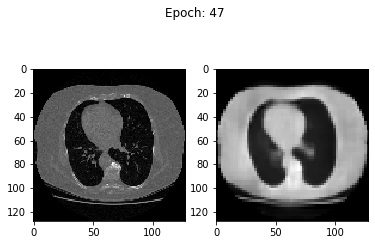

>44323, d1[0.844] d2[6.791] g[1.854]
>44324, d1[0.844] d2[6.791] g[1.855]
>44325, d1[0.844] d2[6.791] g[2.009]
>44326, d1[0.844] d2[6.791] g[2.033]
>44327, d1[0.844] d2[6.791] g[2.193]
>44328, d1[0.844] d2[6.791] g[2.071]
>44329, d1[0.844] d2[6.791] g[2.001]
>44330, d1[0.844] d2[6.791] g[2.147]
>44331, d1[0.844] d2[6.791] g[1.864]
>44332, d1[0.844] d2[6.791] g[1.869]
>44333, d1[0.844] d2[6.791] g[1.981]
>44334, d1[0.844] d2[6.791] g[1.863]
>44335, d1[0.844] d2[6.791] g[1.863]
>44336, d1[0.844] d2[6.791] g[1.835]
>44337, d1[0.844] d2[6.791] g[2.131]
>44338, d1[0.844] d2[6.791] g[2.116]
>44339, d1[0.844] d2[6.791] g[1.872]
>44340, d1[0.844] d2[6.791] g[1.897]
>44341, d1[0.844] d2[6.791] g[1.968]
>44342, d1[0.844] d2[6.791] g[1.975]
>44343, d1[0.844] d2[6.791] g[2.066]
>44344, d1[0.844] d2[6.791] g[1.881]
>44345, d1[0.844] d2[6.791] g[1.885]
>44346, d1[0.844] d2[6.791] g[1.919]
>44347, d1[0.844] d2[6.791] g[2.018]
>44348, d1[0.844] d2[6.791] g[2.043]
>44349, d1[0.844] d2[6.791] g[2.048]
>

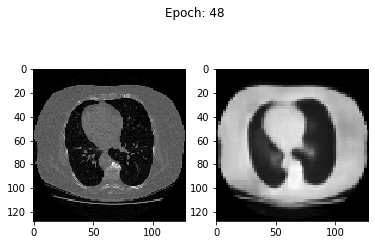

>45266, d1[0.844] d2[6.791] g[2.002]
>45267, d1[0.844] d2[6.791] g[2.046]
>45268, d1[0.844] d2[6.791] g[2.190]
>45269, d1[0.844] d2[6.791] g[1.887]
>45270, d1[0.844] d2[6.791] g[2.073]
>45271, d1[0.844] d2[6.791] g[1.861]
>45272, d1[0.844] d2[6.791] g[2.015]
>45273, d1[0.844] d2[6.791] g[2.045]
>45274, d1[0.844] d2[6.791] g[2.002]
>45275, d1[0.844] d2[6.791] g[2.073]
>45276, d1[0.844] d2[6.791] g[1.964]
>45277, d1[0.844] d2[6.791] g[1.896]
>45278, d1[0.844] d2[6.791] g[2.004]
>45279, d1[0.844] d2[6.791] g[1.838]
>45280, d1[0.844] d2[6.791] g[1.910]
>45281, d1[0.844] d2[6.791] g[2.030]
>45282, d1[0.844] d2[6.791] g[1.901]
>45283, d1[0.844] d2[6.791] g[2.252]
>45284, d1[0.844] d2[6.791] g[1.866]
>45285, d1[0.844] d2[6.791] g[2.186]
>45286, d1[0.844] d2[6.791] g[1.947]
>45287, d1[0.844] d2[6.791] g[1.837]
>45288, d1[0.844] d2[6.791] g[1.852]
>45289, d1[0.844] d2[6.791] g[1.921]
>45290, d1[0.844] d2[6.791] g[2.104]
>45291, d1[0.844] d2[6.791] g[1.890]
>45292, d1[0.844] d2[6.791] g[1.896]
>

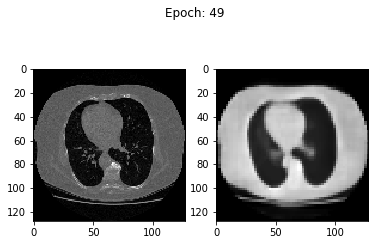

>46209, d1[0.844] d2[6.791] g[1.844]
>46210, d1[0.844] d2[6.791] g[2.110]
>46211, d1[0.844] d2[6.791] g[1.829]
>46212, d1[0.844] d2[6.791] g[1.868]
>46213, d1[0.844] d2[6.791] g[2.107]
>46214, d1[0.844] d2[6.791] g[1.857]
>46215, d1[0.844] d2[6.791] g[1.885]
>46216, d1[0.844] d2[6.791] g[1.869]
>46217, d1[0.844] d2[6.791] g[1.997]
>46218, d1[0.844] d2[6.791] g[2.152]
>46219, d1[0.844] d2[6.791] g[1.846]
>46220, d1[0.844] d2[6.791] g[1.983]
>46221, d1[0.844] d2[6.791] g[2.099]
>46222, d1[0.844] d2[6.791] g[1.896]
>46223, d1[0.844] d2[6.791] g[1.890]
>46224, d1[0.844] d2[6.791] g[2.098]
>46225, d1[0.844] d2[6.791] g[1.995]
>46226, d1[0.844] d2[6.791] g[2.078]
>46227, d1[0.844] d2[6.791] g[2.101]
>46228, d1[0.844] d2[6.791] g[1.921]
>46229, d1[0.844] d2[6.791] g[2.169]
>46230, d1[0.844] d2[6.791] g[1.865]
>46231, d1[0.844] d2[6.791] g[1.976]
>46232, d1[0.844] d2[6.791] g[2.052]
>46233, d1[0.844] d2[6.791] g[2.017]
>46234, d1[0.844] d2[6.791] g[1.873]
>46235, d1[0.844] d2[6.791] g[1.956]
>

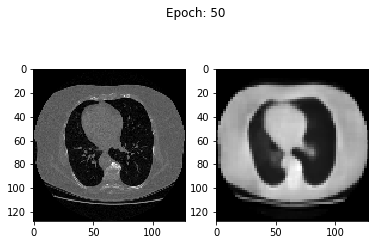

>47152, d1[0.844] d2[6.791] g[2.076]
>47153, d1[0.844] d2[6.791] g[1.882]
>47154, d1[0.844] d2[6.791] g[2.042]
>47155, d1[0.844] d2[6.791] g[2.057]
>47156, d1[0.844] d2[6.791] g[2.034]
>47157, d1[0.844] d2[6.791] g[2.075]
>47158, d1[0.844] d2[6.791] g[2.068]
>47159, d1[0.844] d2[6.791] g[1.926]
>47160, d1[0.844] d2[6.791] g[1.874]
>47161, d1[0.844] d2[6.791] g[2.090]
>47162, d1[0.844] d2[6.791] g[1.910]
>47163, d1[0.844] d2[6.791] g[2.033]
>47164, d1[0.844] d2[6.791] g[1.926]
>47165, d1[0.844] d2[6.791] g[2.028]
>47166, d1[0.844] d2[6.791] g[1.905]
>47167, d1[0.844] d2[6.791] g[1.909]
>47168, d1[0.844] d2[6.791] g[1.832]
>47169, d1[0.844] d2[6.791] g[1.849]
>47170, d1[0.844] d2[6.791] g[1.934]
>47171, d1[0.844] d2[6.791] g[1.921]
>47172, d1[0.844] d2[6.791] g[2.023]
>47173, d1[0.844] d2[6.791] g[2.084]
>47174, d1[0.844] d2[6.791] g[1.837]
>47175, d1[0.844] d2[6.791] g[2.036]
>47176, d1[0.844] d2[6.791] g[1.964]
>47177, d1[0.844] d2[6.791] g[2.113]
>47178, d1[0.844] d2[6.791] g[1.866]
>

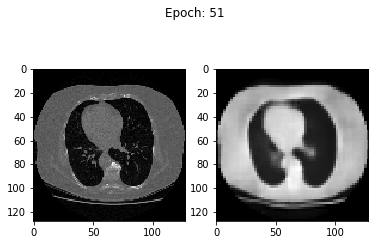

>48095, d1[0.844] d2[6.791] g[1.817]
>48096, d1[0.844] d2[6.791] g[2.104]
>48097, d1[0.844] d2[6.791] g[1.971]
>48098, d1[0.844] d2[6.791] g[1.958]
>48099, d1[0.844] d2[6.791] g[2.014]
>48100, d1[0.844] d2[6.791] g[1.818]
>48101, d1[0.844] d2[6.791] g[2.221]
>48102, d1[0.844] d2[6.791] g[1.972]
>48103, d1[0.844] d2[6.791] g[1.978]
>48104, d1[0.844] d2[6.791] g[2.085]
>48105, d1[0.844] d2[6.791] g[2.062]
>48106, d1[0.844] d2[6.791] g[1.904]
>48107, d1[0.844] d2[6.791] g[1.847]
>48108, d1[0.844] d2[6.791] g[1.860]
>48109, d1[0.844] d2[6.791] g[1.935]
>48110, d1[0.844] d2[6.791] g[1.952]
>48111, d1[0.844] d2[6.791] g[2.098]
>48112, d1[0.844] d2[6.791] g[2.045]
>48113, d1[0.844] d2[6.791] g[1.852]
>48114, d1[0.844] d2[6.791] g[2.039]
>48115, d1[0.844] d2[6.791] g[1.839]
>48116, d1[0.844] d2[6.791] g[1.938]
>48117, d1[0.844] d2[6.791] g[2.253]
>48118, d1[0.844] d2[6.791] g[2.123]
>48119, d1[0.844] d2[6.791] g[2.012]
>48120, d1[0.844] d2[6.791] g[1.855]
>48121, d1[0.844] d2[6.791] g[2.048]
>

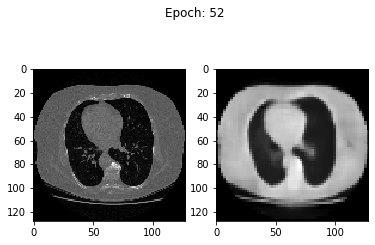

>49038, d1[0.844] d2[6.791] g[2.137]
>49039, d1[0.844] d2[6.791] g[1.870]
>49040, d1[0.844] d2[6.791] g[1.915]
>49041, d1[0.844] d2[6.791] g[2.031]
>49042, d1[0.844] d2[6.791] g[1.980]
>49043, d1[0.844] d2[6.791] g[1.931]
>49044, d1[0.844] d2[6.791] g[2.091]
>49045, d1[0.844] d2[6.791] g[2.033]
>49046, d1[0.844] d2[6.791] g[2.163]
>49047, d1[0.844] d2[6.791] g[2.086]
>49048, d1[0.844] d2[6.791] g[1.886]
>49049, d1[0.844] d2[6.791] g[1.851]
>49050, d1[0.844] d2[6.791] g[1.957]
>49051, d1[0.844] d2[6.791] g[1.875]
>49052, d1[0.844] d2[6.791] g[1.887]
>49053, d1[0.844] d2[6.791] g[1.860]
>49054, d1[0.844] d2[6.791] g[1.838]
>49055, d1[0.844] d2[6.791] g[1.888]
>49056, d1[0.844] d2[6.791] g[1.902]
>49057, d1[0.844] d2[6.791] g[1.922]
>49058, d1[0.844] d2[6.791] g[2.193]
>49059, d1[0.844] d2[6.791] g[2.089]
>49060, d1[0.844] d2[6.791] g[2.066]
>49061, d1[0.844] d2[6.791] g[1.896]
>49062, d1[0.844] d2[6.791] g[2.192]
>49063, d1[0.844] d2[6.791] g[2.004]
>49064, d1[0.844] d2[6.791] g[1.870]
>

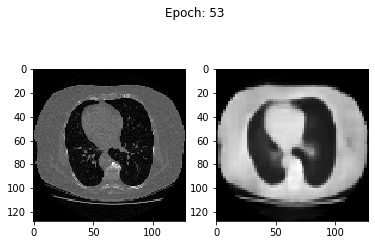

>49981, d1[0.844] d2[6.791] g[1.971]
>49982, d1[0.844] d2[6.791] g[1.894]
>49983, d1[0.844] d2[6.791] g[1.889]
>49984, d1[0.844] d2[6.791] g[1.940]
>49985, d1[0.844] d2[6.791] g[1.976]
>49986, d1[0.844] d2[6.791] g[2.060]
>49987, d1[0.844] d2[6.791] g[2.115]
>49988, d1[0.844] d2[6.791] g[1.841]
>49989, d1[0.844] d2[6.791] g[2.227]
>49990, d1[0.844] d2[6.791] g[2.143]
>49991, d1[0.844] d2[6.791] g[1.988]
>49992, d1[0.844] d2[6.791] g[1.832]
>49993, d1[0.844] d2[6.791] g[1.911]
>49994, d1[0.844] d2[6.791] g[2.134]
>49995, d1[0.844] d2[6.791] g[2.071]
>49996, d1[0.844] d2[6.791] g[2.004]
>49997, d1[0.844] d2[6.791] g[1.866]
>49998, d1[0.844] d2[6.791] g[1.941]
>49999, d1[0.844] d2[6.791] g[1.820]
>50000, d1[0.844] d2[6.791] g[1.917]


KeyboardInterrupt: 

In [12]:
gd.train(d_model, g_model, gan, 200, 1, 16)

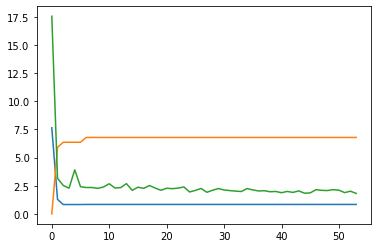

In [17]:
plt.plot(gd.d1_epoch_losses)
plt.plot(gd.d2_epoch_losses)
plt.plot(gd.g_epoch_losses)
plt.show()

In [ ]:
test_vv = g_model.predict(np.reshape(gd.x_train[100], (1, 1024, 1024, 1)))


In [ ]:
test_vv = np.reshape(test_vv, (128, 128, 128))

plt.imshow(test_vv[64], cmap = 'gray')
plt.show()

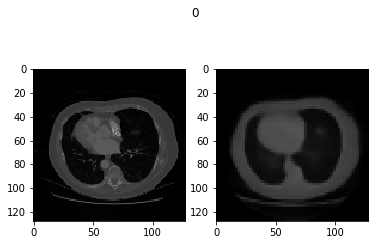

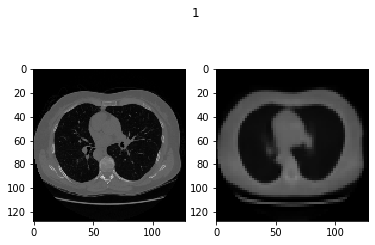

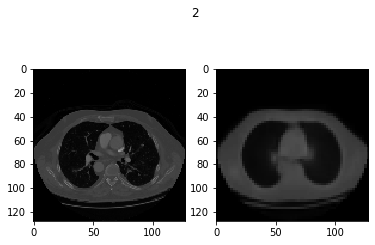

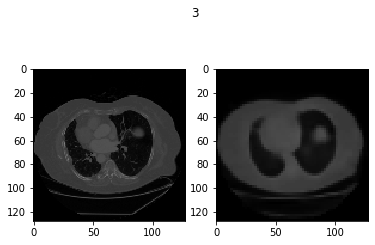

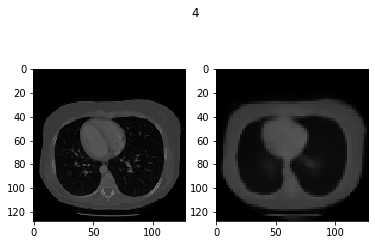

...

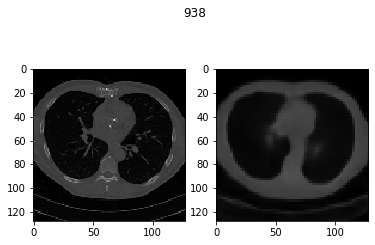

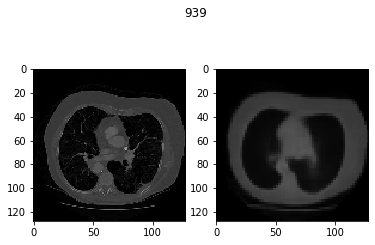

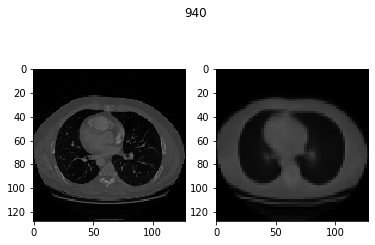

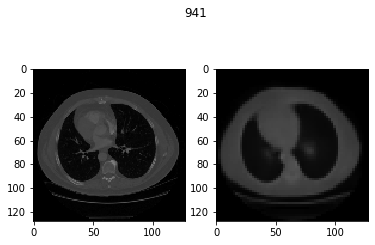

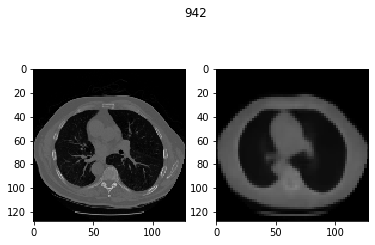

In [18]:
for i in range(0, 943):
    
    test_vv = g_model.predict(np.reshape(gd.x_train[i], (1, 1024, 1024, 1)))
    test_vv = np.reshape(test_vv, (128, 128, 128))
    actual = np.reshape(gd.y_train[i], (128, 128, 128))
    
    f = plt.figure()
    
    f.add_subplot(1, 2, 1)
    plt.imshow(actual[64], cmap = 'gray', vmin = 0, vmax = 1)
    
    f.add_subplot(1, 2, 2)
    plt.imshow(test_vv[64], cmap = 'gray', vmin = 0, vmax = 1)
    
    plt.suptitle(i)
    plt.show(block = True)

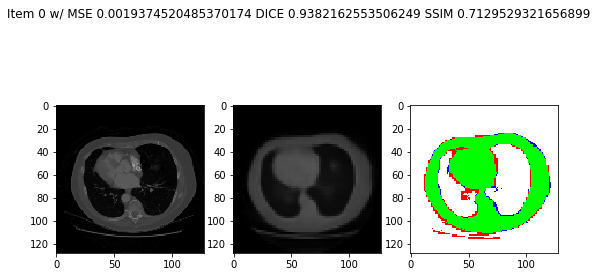

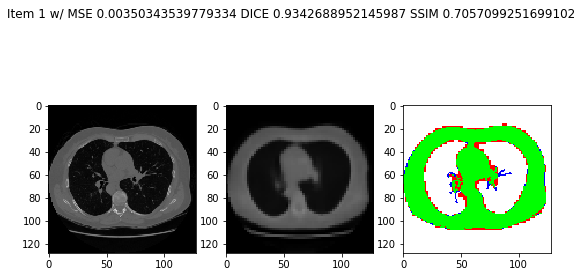

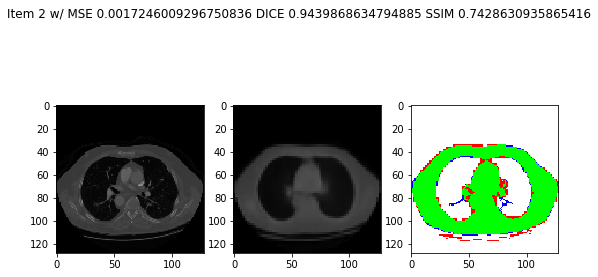

/home/ec2-user/anaconda3/envs/python3/lib/python3.6/site-packages/matplotlib/image.py:397: UserWarning: Warning: converting a masked element to nan.
  dv = (np.float64(self.norm.vmax) -
<string>:6: UserWarning: Warning: converting a masked element to nan.
/home/ec2-user/anaconda3/envs/python3/lib/python3.6/site-packages/numpy/ma/core.py:722: UserWarning: Warning: converting a masked element to nan.
  data = np.array(a, copy=False, subok=subok)


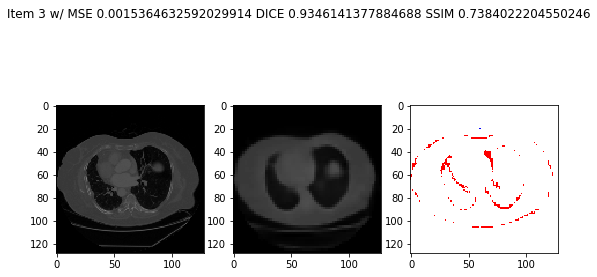

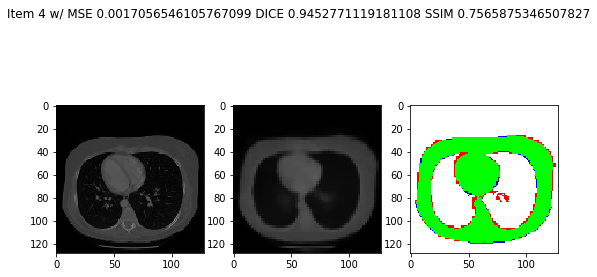

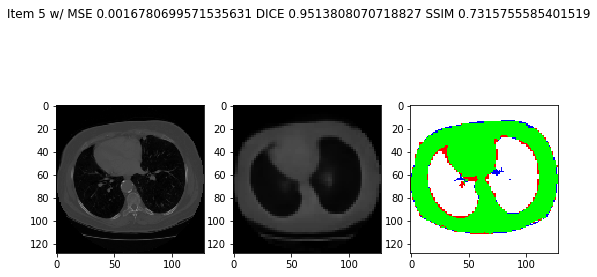

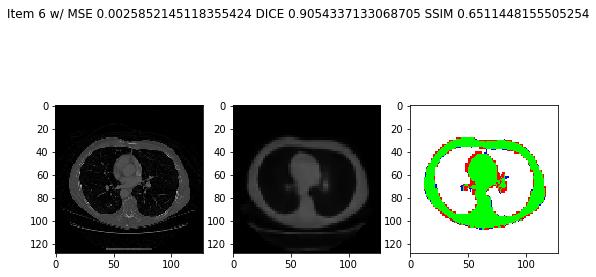

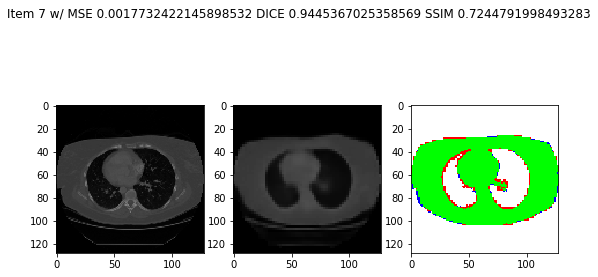

...

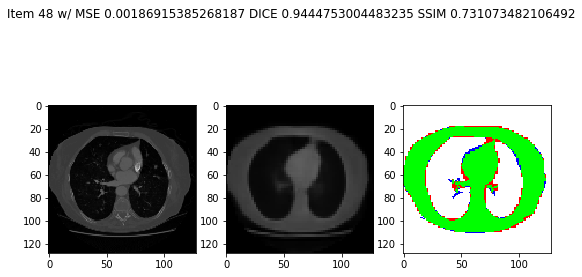

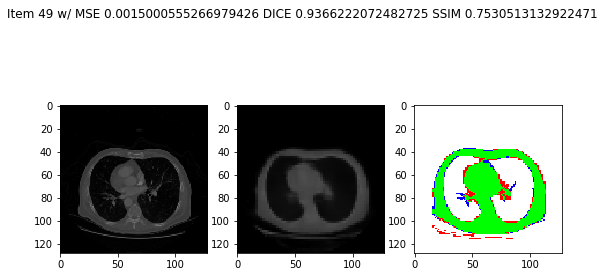

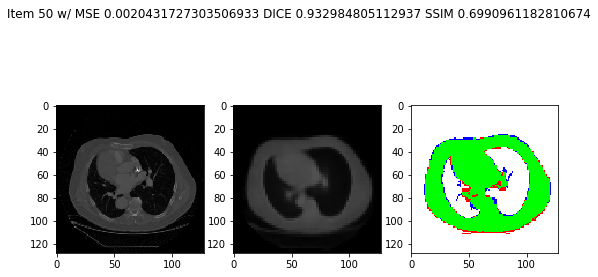

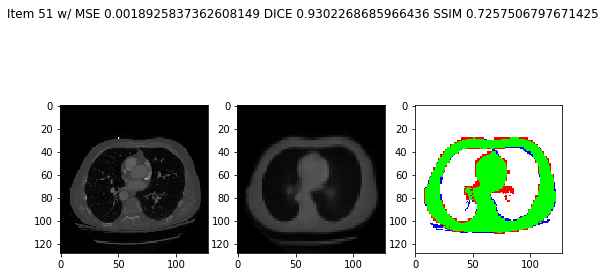

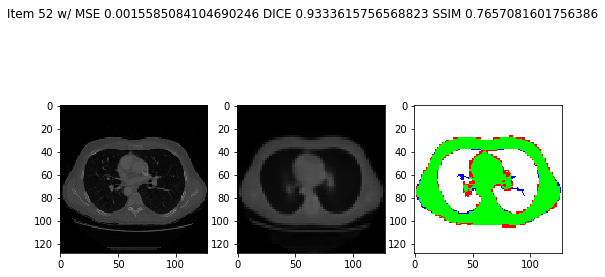

KeyboardInterrupt: 

In [19]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.metrics import mean_squared_error
from skimage.metrics import structural_similarity
import cv2 as cv
import numpy.ma as ma

def dice_score(im1, im2, empty_score=1.0):
    """
    Computes the Dice coefficient, a measure of set similarity.
    Parameters
    ----------
    im1 : array-like, bool
        Any array of arbitrary size. If not boolean, will be converted.
    im2 : array-like, bool
        Any other array of identical size. If not boolean, will be converted.
    Returns
    -------
    dice : float
        Dice coefficient as a float on range [0,1].
        Maximum similarity = 1
        No similarity = 0
        Both are empty (sum eq to zero) = empty_score
        
    Notes
    -----
    The order of inputs for `dice` is irrelevant. The result will be
    identical if `im1` and `im2` are switched.
    """
    im1 = np.asarray(im1).astype(np.bool)
    im2 = np.asarray(im2).astype(np.bool)

    if im1.shape != im2.shape:
        raise ValueError("Shape mismatch: im1 and im2 must have the same shape.")

    im_sum = im1.sum() + im2.sum()
    if im_sum == 0:
        return empty_score

    # Compute Dice coefficient
    intersection = np.logical_and(im1, im2)

    return 2. * intersection.sum() / im_sum

def extract_slice_mask(slice):

    ret, thresh = cv.threshold(slice, 0.1, 1, cv.THRESH_BINARY)
    num_labels, labels_im, stats, centroids = cv.connectedComponentsWithStats(thresh.astype('uint8'))

    max = stats[1, 4]
    largest_index = 1

    for k in np.delete(np.unique(labels_im), 0):

        size = stats[k, 4]
        if (size > max):

            max = size
            largest_index = k

    mask = ma.masked_not_equal(labels_im, largest_index)
    return mask

def extract_lung_mask(volume, size = 128):

    slices = []

    for i in range(0, size):

        masked_slice = extract_slice_mask(volume[i])
        slices.append(masked_slice)

    slices = np.array(slices)
    return slices

def tpfp(truth, prediction):

    h, w, l = truth.shape[0], truth.shape[1], truth.shape[2]

    tp = np.zeros(truth.shape)
    fp = np.zeros(truth.shape)
    fn = np.zeros(truth.shape)
    tn = np.zeros(truth.shape)

    truth_mask = extract_lung_mask(truth)
    pred_mask = extract_lung_mask(prediction)

    for i in range(0, h):

        for j in range(0, w):

            for k in range(0, l):

                if (truth_mask[i, j, k] == 1 and pred_mask[i, j, k] == 1):

                    tp[i, j, k] = 1

                elif (truth_mask[i, j, k] == 1 and pred_mask[i, j, k] == 0):

                    fn[i, j, k] = 1

                elif (truth_mask[i, j, k] == 0 and pred_mask[i, j, k] == 1):

                    fp[i, j, k] = 1

                else:

                    tn[i, j, k] = 1

    tp = ma.masked_values(tp * 100, 0)
    fp = ma.masked_values(fp * 50, 0)
    fn = ma.masked_values(fn, 0)
    
    prdd = pred_mask[64]
    trdd = truth_mask[64]

    #dice = np.sum(prdd[trdd==1])*2.0 / (np.sum(prdd) + np.sum(trdd))
    dice = dice_score(truth_mask, pred_mask)
    return tp, fp, fn, dice

mses = []
ssims = []
dices = []

for i in range(0, 943):
        
    original = np.reshape(gd.y_train[i], (128, 128, 128))
    input_1 = np.reshape(gd.x_train[i], (1, 1024, 1024, 1))
    output_1 = np.reshape(g_model.predict(input_1), (128, 128, 128))
    
    mse = mean_squared_error(original, output_1)
    ssim = structural_similarity(original, output_1, data_range = 1)
    
    tp, fp, fn, dice = tpfp(original, output_1)
    f = plt.figure(figsize = (9, 5))
    
    f.add_subplot(1, 3, 1)
    plt.imshow(original[64], cmap = 'gray', vmin = 0, vmax = 1)
    
    f.add_subplot(1, 3, 2)
    plt.imshow(output_1[64], cmap = 'gray', vmin = 0, vmax = 1)
    
    f.add_subplot(1, 3, 3)
    plt.imshow(tp[64], cmap = 'brg', vmin = 0.1) #green
    plt.imshow(fp[64], cmap = 'brg', vmin = 0.1, vmax = 100) #red
    plt.imshow(fn[64], cmap = 'brg', vmin = 0.1, vmax = 90) #blue
    
    mses.append(mse)
    ssims.append(ssim)
    dices.append(dice)
    
    plt.suptitle("Item {} w/ MSE {} DICE {} SSIM {}".format(i, mse, dice, ssim))
    plt.show(block = True)

In [21]:
from statistics import mean
print("MSE MEAN: {}".format(mean(mses)))
print("SSIM MEAN: {}".format(mean(ssims)))
print("LUNG DICE MEAN: {}".format(mean(dices)))

MSE MEAN: 0.002035416062190891
SSIM MEAN: 0.7247440408231995
LUNG DICE MEAN: 0.9337195108455664


In [23]:
g_model.save('G_MODEL_h5', save_format = 'h5')
d_model.save('D_MODEL_h5', save_format = 'h5')
gan.save('GAN_MODEL_h5', save_format = 'h5')